# Emojify! 

Welcome to the second assignment of Week 2! You're going to use word vector representations to build an Emojifier. 
🤩 💫 🔥

Have you ever wanted to make your text messages more expressive? Your emojifier app will help you do that. 
Rather than writing:
>"Congratulations on the promotion! Let's get coffee and talk. Love you!"   

The emojifier can automatically turn this into:
>"Congratulations on the promotion! 👍  Let's get coffee and talk. ☕️ Love you! ❤️"

You'll implement a model which inputs a sentence (such as "Let's go see the baseball game tonight!") and finds the most appropriate emoji to be used with this sentence (⚾️).

### Using Word Vectors to Improve Emoji Lookups
* In many emoji interfaces, you need to remember that ❤️  is the "heart" symbol rather than the "love" symbol. 
    * In other words, you'll have to remember to type "heart" to find the desired emoji, and typing "love" won't bring up that symbol.
* You can make a more flexible emoji interface by using word vectors!
* When using word vectors, you'll see that even if your training set explicitly relates only a few words to a particular emoji, your algorithm will be able to generalize and associate additional words in the test set to the same emoji.
    * This works even if those additional words don't even appear in the training set. 
    * This allows you to build an accurate classifier mapping from sentences to emojis, even using a small training set. 

### What you'll build:
1. In this exercise, you'll start with a baseline model (Emojifier-V1) using word embeddings.
2. Then you will build a more sophisticated model (Emojifier-V2) that further incorporates an LSTM. 

By the end of this notebook, you'll be able to:

* Create an embedding layer in Keras with pre-trained word vectors
* Explain the advantages and disadvantages of the GloVe algorithm
* Describe how negative sampling learns word vectors more efficiently than other methods
* Build a sentiment classifier using word embeddings
* Build and train a more sophisticated classifier using an LSTM

🏀 👑

👆 😎

(^^^ Emoji for "skills") 

## Important Note on Submission to the AutoGrader

Before submitting your assignment to the AutoGrader, please make sure you are not doing the following:

1. You have not added any _extra_ `print` statement(s) in the assignment.
2. You have not added any _extra_ code cell(s) in the assignment.
3. You have not changed any of the function parameters.
4. You are not using any global variables inside your graded exercises. Unless specifically instructed to do so, please refrain from it and use the local variables instead.
5. You are not changing the assignment code where it is not required, like creating _extra_ variables.

If you do any of the following, you will get something like, `Grader not found` (or similarly unexpected) error upon submitting your assignment. Before asking for help/debugging the errors in your assignment, check for these first. If this is the case, and you don't remember the changes you have made, you can get a fresh copy of the assignment by following these [instructions](https://www.coursera.org/learn/nlp-sequence-models/supplement/qHIve/h-ow-to-refresh-your-workspace).

## Table of Contents

- [Packages](#0)
- [1 - Baseline Model: Emojifier-V1](#1)
    - [1.1 - Dataset EMOJISET](#1-1)
    - [1.2 - Overview of the Emojifier-V1](#1-2)
    - [1.3 - Implementing Emojifier-V1](#1-3)
        - [Exercise 1 - sentence_to_avg](#ex-1)
    - [1.4 - Implement the Model](#1-4)
        - [Exercise 2 - model](#ex-2)
    - [1.5 - Examining Test Set Performance](#1-5)
- [2 - Emojifier-V2: Using LSTMs in Keras](#2)
    - [2.1 - Model Overview](#2-1)
    - [2.2 Keras and Mini-batching](#2-2)
    - [2.3 - The Embedding Layer](#2-3)
        - [Exercise 3 - sentences_to_indices](#ex-3)
        - [Exercise 4 - pretrained_embedding_layer](#ex-4)
    - [2.4 - Building the Emojifier-V2](#2-4)
        - [Exercise 5 - Emojify_V2](#ex-5)
    - [2.5 - Train the Model](#2-5)
- [3 - Acknowledgments](#3)

<a name='0'></a>
## Packages

Let's get started! Run the following cell to load the packages you're going to use. 

In [1]:
import numpy as np
from emo_utils import *
import emoji
import matplotlib.pyplot as plt
from test_utils import *

%matplotlib inline

<a name='1'></a>
## 1 - Baseline Model: Emojifier-V1

<a name='1-1'></a>
### 1.1 - Dataset EMOJISET

Let's start by building a simple baseline classifier. 

You have a tiny dataset (X, Y) where:
- X contains 127 sentences (strings).
- Y contains an integer label between 0 and 4 corresponding to an emoji for each sentence.

<img src="images/data_set.png" style="width:700px;height:300px;">
<caption><center><font color='purple'><b>Figure 1</b>: EMOJISET - a classification problem with 5 classes. A few examples of sentences are given here. </center></caption>

Load the dataset using the code below. The dataset is split between training (127 examples) and testing (56 examples).

In [2]:
X_train, Y_train = read_csv('data/train_emoji.csv')
X_test, Y_test = read_csv('data/tesss.csv')

In the below code cell, you will find out the sentence with the maximum number of words, and will store it's length in `maxLen` (*i.e., the number of words in the longest sentence, which will be used further*). Let's break down this code for a better understanding.

- The first point to note here is that `split()` breaks a string into a list of it's words. So, if `x` is a string, then `len(x.split())` returns the number of words in that string. You can read more about `split` [here](https://docs.python.org/3/library/stdtypes.html?highlight=split#str.split).

- The second point to note here is the way in which `max` function has been used. As can be read [here](https://docs.python.org/3/library/functions.html#max), apart from an iterable (*which in your case is `X_train`, a list of strings*), this function also has a `key` argument, that can be used to modify the basis on which the largest element in the iterable is chosen.

In this case, `key` has been chosen as the number of words in a string. So the `max` function will return the string with the largest number of words.

In [3]:
maxLen = len(max(X_train, key=lambda x: len(x.split())).split())

Run the following cell to print sentences from X_train and corresponding labels from Y_train. 
* Change `idx` to see different examples. 
* Note that due to the font used by iPython notebook, the heart emoji may be colored black rather than red.

In [4]:
for idx in range(10):
    print(X_train[idx], label_to_emoji(Y_train[idx]))

never talk to me again 😞
I am proud of your achievements 😄
It is the worst day in my life 😞
Miss you so much ❤️
food is life 🍴
I love you mum ❤️
Stop saying bullshit 😞
congratulations on your acceptance 😄
The assignment is too long  😞
I want to go play ⚾


<a name='1-2'></a>
### 1.2 - Overview of the Emojifier-V1

In this section, you'll implement a baseline model called "Emojifier-v1".  

<center>
<img src="images/image_1.png" style="width:900px;height:300px;">
    <caption><center><font color='purple'><b>Figure 2</b>: Baseline model (Emojifier-V1).</center></caption>
</center></font>


#### Inputs and Outputs
* The input of the model is a string corresponding to a sentence (e.g. "I love you"). 
* The output will be a probability vector of shape (1,5), (indicating that there are 5 emojis to choose from).
* The (1,5) probability vector is passed to an argmax layer, which extracts the index of the emoji with the highest probability.

#### One-hot Encoding
* To get your labels into a format suitable for training a softmax classifier, convert $Y$ from its current shape  $(m, 1)$ into a "one-hot representation" $(m, 5)$, 
    * Each row is a one-hot vector giving the label of one example.
    * Here, `Y_oh` stands for "Y-one-hot" in the variable names `Y_oh_train` and `Y_oh_test`: 

In [5]:
Y_oh_train = convert_to_one_hot(Y_train, C = 5)
Y_oh_test = convert_to_one_hot(Y_test, C = 5)

Now, see what `convert_to_one_hot()` did. Feel free to change `index` to print out different values. 

In [6]:
idx = 50
print(f"Sentence '{X_train[idx]}' has label index {Y_train[idx]}, which is emoji {label_to_emoji(Y_train[idx])}", )
print(f"Label index {Y_train[idx]} in one-hot encoding format is {Y_oh_train[idx]}")

Sentence 'I missed you' has label index 0, which is emoji ❤️
Label index 0 in one-hot encoding format is [1. 0. 0. 0. 0.]


All the data is now ready to be fed into the Emojify-V1 model. You're ready to implement the model!

<a name='1-3'></a>
### 1.3 - Implementing Emojifier-V1

As shown in Figure 2 (above), the first step is to:
* Convert each word in the input sentence into their word vector representations.
* Take an average of the word vectors. 

Similar to this week's previous assignment, you'll use pre-trained 50-dimensional GloVe embeddings. 

Run the following cell to load the `word_to_vec_map`, which contains all the vector representations.

In [7]:
word_to_index, index_to_word, word_to_vec_map = read_glove_vecs('data/glove.6B.50d.txt')

You've loaded:
- `word_to_index`: dictionary mapping from words to their indices in the vocabulary 
    - (400,001 words, with the valid indices ranging from 0 to 400,000)
- `index_to_word`: dictionary mapping from indices to their corresponding words in the vocabulary
- `word_to_vec_map`: dictionary mapping words to their GloVe vector representation.

Run the following cell to check if it works:

In [8]:
word = "cucumber"
idx = 289846
print("the index of", word, "in the vocabulary is", word_to_index[word])
print("the", str(idx) + "th word in the vocabulary is", index_to_word[idx])

the index of cucumber in the vocabulary is 113317
the 289846th word in the vocabulary is potatos


<a name='ex-1'></a>
### Exercise 1 - sentence_to_avg

Implement `sentence_to_avg()` 

You'll need to carry out two steps:

1. Convert every sentence to lower-case, then split the sentence into a list of words. 
    * `X.lower()` and `X.split()` might be useful. 😉
2. For each word in the sentence, access its GloVe representation.
    * Then take the average of all of these word vectors.
    * You might use `numpy.zeros()`, which you can read more about [here]('https://numpy.org/doc/stable/reference/generated/numpy.zeros.html').
    
    
#### Additional Hints
* When creating the `avg` array of zeros, you'll want it to be a vector of the same shape as the other word vectors in the `word_to_vec_map`.  
    * You can choose a word that exists in the `word_to_vec_map` and access its `.shape` field.
    * Be careful not to hard-code the word that you access.  In other words, don't assume that if you see the word 'the' in the `word_to_vec_map` within this notebook, that this word will be in the `word_to_vec_map` when the function is being called by the automatic grader.

**Hint**: you can use any one of the word vectors that you retrieved from the input `sentence` to find the shape of a word vector.

In [63]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: sentence_to_avg

def sentence_to_avg(sentence, word_to_vec_map):
    """
    Converts a sentence (string) into a list of words (strings). Extracts the GloVe representation of each word
    and averages its value into a single vector encoding the meaning of the sentence.
    
    Arguments:
    sentence -- string, one training example from X
    word_to_vec_map -- dictionary mapping every word in a vocabulary into its 50-dimensional vector representation
    
    Returns:
    avg -- average vector encoding information about the sentence, numpy-array of shape (J,), where J can be any number
    """
    # Get a valid word contained in the word_to_vec_map. 
    any_word = list(word_to_vec_map.keys())[0]
    
    ### START CODE HERE ###
    # Step 1: Split sentence into list of lower case words (≈ 1 line)
    words = sentence.lower().split()


    # Initialize the average word vector, should have the same shape as your word vectors.
    # Use `np.zeros` and pass in the argument of any word's word 2 vec's shape
    avg = np.zeros(word_to_vec_map[any_word].shape)
    
    # Initialize count to 0
    count = 0
    
    # Step 2: average the word vectors. You can loop over the words in the list "words".
    for w in words:
        # Check that word exists in word_to_vec_map
        if w in word_to_vec_map.keys():
            avg += word_to_vec_map[w]
            # Increment count
            count +=1
          
    if count > 0:
        print(avg)
        # Get the average. But only if count > 0
        avg = avg/count
    
    ### END CODE HERE ###
    
    return avg

In [64]:
### YOU CANNOT EDIT THIS CELL

# BEGIN UNIT TEST
avg = sentence_to_avg("Morrocan couscous is my favorite dish", word_to_vec_map)
print("avg = \n", avg)

def sentence_to_avg_test(target):
    # Create a controlled word to vec map
    word_to_vec_map = {'a': [3, 3], 'synonym_of_a': [3, 3], 'a_nw': [2, 4], 'a_s': [3, 2], 
                       'c': [-2, 1], 'c_n': [-2, 2],'c_ne': [-1, 2], 'c_e': [-1, 1], 'c_se': [-1, 0], 
                       'c_s': [-2, 0], 'c_sw': [-3, 0], 'c_w': [-3, 1], 'c_nw': [-3, 2]
                      }
    # Convert lists to np.arrays
    for key in word_to_vec_map.keys():
        word_to_vec_map[key] = np.array(word_to_vec_map[key])
        
    avg = target("a a_nw c_w a_s", word_to_vec_map)
    assert tuple(avg.shape) == tuple(word_to_vec_map['a'].shape),  "Check the shape of your avg array"  
    assert np.allclose(avg, [1.25, 2.5]),  "Check that you are finding the 4 words"
    avg = target("love a a_nw c_w a_s", word_to_vec_map)
    assert np.allclose(avg, [1.25, 2.5]), "Divide by count, not len(words)"
    avg = target("love", word_to_vec_map)
    assert np.array_equal(avg, [0, 0]), "Average of no words must give an array of zeros"
    avg = target("c_se foo a a_nw c_w a_s deeplearning c_nw", word_to_vec_map)
    assert np.allclose(avg, [0.1666667, 2.0]), "Debug the last example"
    
    print("\033[92mAll tests passed!")
    
sentence_to_avg_test(sentence_to_avg)

# END UNIT TEST

[-0.04803    3.38225   -3.02564    1.55319    3.3078662  0.186299
 -1.2608231  1.013636  -0.575416   0.850704  -0.942538   1.111552
  3.897471   2.302267   1.26613    0.6781     0.156838   1.562266
  0.34924   -0.09469   -0.72473   -0.148276   2.477073   3.0912366
  2.32537   -5.391966  -3.21087    2.01007    4.128416  -1.293759
 10.78293    0.628616  -2.20652    4.50471    0.616955   2.09355
 -1.63577    4.00608   -0.64237   -1.70181    3.574807   1.72484
 -2.019981   1.403629   2.060951   1.07043    0.699693  -0.458598
  0.8672502  0.58852  ]
avg = 
 [-0.008005    0.56370833 -0.50427333  0.258865    0.55131103  0.03104983
 -0.21013718  0.16893933 -0.09590267  0.141784   -0.15708967  0.18525867
  0.6495785   0.38371117  0.21102167  0.11301667  0.02613967  0.26037767
  0.05820667 -0.01578167 -0.12078833 -0.02471267  0.4128455   0.5152061
  0.38756167 -0.898661   -0.535145    0.33501167  0.68806933 -0.2156265
  1.797155    0.10476933 -0.36775333  0.750785    0.10282583  0.348925
 -0.272

<a name='1-4'></a>
### 1.4 - Implement the Model

You now have all the pieces to finish implementing the `model()` function! 
After using `sentence_to_avg()` you need to:
* Pass the average through forward propagation
* Compute the cost
* Backpropagate to update the softmax parameters

<a name='ex-2'></a>
### Exercise 2 - model

Implement the `model()` function described in Figure (2). 

* The equations you need to implement in the forward pass and to compute the cross-entropy cost are below:
* The variable $Y_{oh}$ ("Y one hot") is the one-hot encoding of the output labels. 

$$ z^{(i)} = Wavg^{(i)} + b$$

$$ a^{(i)} = softmax(z^{(i)})$$

$$ \mathcal{L}^{(i)} = - \sum_{k = 0}^{n_y - 1} Y_{oh,k}^{(i)} * log(a^{(i)}_k)$$

**Note**: It is possible to come up with a more efficient vectorized implementation. For now, just use nested for loops to better understand the algorithm, and for easier debugging.

The function `softmax()` is provided, and has already been imported.

In [95]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: model

def model(X, Y, word_to_vec_map, learning_rate = 0.01, num_iterations = 400):
    """
    Model to train word vector representations in numpy.
    
    Arguments:
    X -- input data, numpy array of sentences as strings, of shape (m,)
    Y -- labels, numpy array of integers between 0 and 7, numpy-array of shape (m, 1)
    word_to_vec_map -- dictionary mapping every word in a vocabulary into its 50-dimensional vector representation
    learning_rate -- learning_rate for the stochastic gradient descent algorithm
    num_iterations -- number of iterations
    
    Returns:
    pred -- vector of predictions, numpy-array of shape (m, 1)
    W -- weight matrix of the softmax layer, of shape (n_y, n_h)
    b -- bias of the softmax layer, of shape (n_y,)
    """
    
    # Get a valid word contained in the word_to_vec_map 
    any_word = list(word_to_vec_map.keys())[0]
        
    # Define number of training examples
    m = Y.shape[0]                             # number of training examples
    n_y = len(np.unique(Y))                    # number of classes  
    n_h = word_to_vec_map[any_word].shape[0]   # dimensions of the GloVe vectors 
    
    # Initialize parameters using Xavier initialization
    W = np.random.randn(n_y, n_h) / np.sqrt(n_h)
    b = np.zeros((n_y,))
    
    # Convert Y to Y_onehot with n_y classes
    Y_oh = convert_to_one_hot(Y, C = n_y) 
    
    # Optimization loop
    for t in range(num_iterations): # Loop over the number of iterations
        
        cost = 0
        dW = 0
        db = 0
        
        for i in range(m):          # Loop over the training examples
            
            ### START CODE HERE ### (≈ 4 lines of code)
            # Average the word vectors of the words from the i'th training example
            avg = sentence_to_avg(X[i], word_to_vec_map)

            # Forward propagate the avg through the softmax layer. 
            # You can use np.dot() to perform the multiplication.
            z = np.dot(W,avg) + b
            a = softmax(z)

            # Add the cost using the i'th training label's one hot representation and "A" (the output of the softmax)
            cost += -np.dot(Y_oh[i], np.log(a))
            ### END CODE HERE ###
            
            # Compute gradients 
            dz = a - Y_oh[i]
            dW += np.dot(dz.reshape(n_y,1), avg.reshape(1, n_h))
            db += dz

            # Update parameters with Stochastic Gradient Descent
            W = W - learning_rate * dW
            b = b - learning_rate * db
            
        assert type(cost) == np.float64, "Incorrect implementation of cost"
        assert cost.shape == (), "Incorrect implementation of cost"
        
        if t % 100 == 0:
            print("Epoch: " + str(t) + " --- cost = " + str(cost))
            pred = predict(X, Y, W, b, word_to_vec_map) #predict is defined in emo_utils.py

    return pred, W, b

In [96]:
### YOU CANNOT EDIT THIS CELL

# UNIT TEST
def model_test(target):
    # Create a controlled word to vec map
    word_to_vec_map = {'a': [3, 3], 'synonym_of_a': [3, 3], 'a_nw': [2, 4], 'a_s': [3, 2], 'a_n': [3, 4], 
                       'c': [-2, 1], 'c_n': [-2, 2],'c_ne': [-1, 2], 'c_e': [-1, 1], 'c_se': [-1, 0], 
                       'c_s': [-2, 0], 'c_sw': [-3, 0], 'c_w': [-3, 1], 'c_nw': [-3, 2]
                      }
    # Convert lists to np.arrays
    for key in word_to_vec_map.keys():
        word_to_vec_map[key] = np.array(word_to_vec_map[key])
        
    # Training set. Sentences composed of a_* words will be of class 0 and sentences composed of c_* words will be of class 1
    X = np.asarray(['a a_s synonym_of_a a_n c_sw', 'a a_s a_n c_sw', 'a_s  a a_n', 'synonym_of_a a a_s a_n c_sw', " a_s a_n",
                    " a a_s a_n c ", " a_n  a c c c_e",
                   'c c_nw c_n c c_ne', 'c_e c c_se c_s', 'c_nw c a_s c_e c_e', 'c_e a_nw c_sw', 'c_sw c c_ne c_ne'])
    
    Y = np.asarray([0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1])
    
    np.random.seed(10)
    pred, W, b = model(X, Y, word_to_vec_map, 0.0025, 110)
    
    assert W.shape == (2, 2), "W must be of shape 2 x 2"
    assert np.allclose(pred.transpose(), Y), "Model must give a perfect accuracy"
    assert np.allclose(b[0], -1 * b[1]), "b should be symmetric in this example"
    
    print("\033[92mAll tests passed!")
    
model_test(model)

[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
Epoch: 0 --- cost = 2.603378473480253
Accuracy: 0.9166666666666666
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 

[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
[ 9. 12.]
[6. 9.]
[9. 9.]
[ 9. 12.]
[6. 6.]
[ 7. 10.]
[ 1. 10.]
[-10.   8.]
[-6.  2.]
[-4.  7.]
[-2.  5.]
[-7.  5.]
All tests passed!


Run the next cell to train your model and learn the softmax parameters (W, b). **The training process will take about 5 minutes**

In [97]:
np.random.seed(1)
pred, W, b = model(X_train, Y_train, word_to_vec_map)
# print(pred)

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649864  -1.33135
  1.47066     1.274851   -0.509852   -0.86492    -1.6842843  -0.373568
 -1.12877    -0.78056     0.400067    1.35431    -0.680681   -1.65699
 -1.43462     0.60877   ]
[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649864  -1.33135
  1.47066     1.274851   -0.509852   -0.86492    -1.6842843  -0.373568
 -1.12877    -0.78056     0.400067    1.35431    -0.680681   -1.65699
 -1.43462     0.60877   ]
[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e+00  6.2291000e-02
  3.5453480e+00 -4.0494000e+00  1.7725200e+01  1.9476310e+00
 -3.5969400e+00 -3.2978100e+00 -8.7740000e-02 -6.4716600e-01
  1.3375720e+00  1.3693210e+00  9.0388600e-01 -1.2767300e+00
 -8.1017000e-01  4.1712400e-01  3.6666000e-01  3.1820800e+00
  2.1698900e-01 -2.8035900e-01 -8.7527300e-01  2.3620721e-01
 -1.9413000e-02  2.4942490e+00]
[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.446

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.297416   -0.181486
   0.40212     1.7664      2.393364   -1.05491    -0.347854    2.69557
  -0.3229222   0.625865    0.525396   -0.232062   -1.98295    -2.199432
   1.529983    0.719899 ]
[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.940

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33849813  0.5448949
 -0.145738    1.8365512  -1.751719    0.942539   -0.84842     0.24178
 -0.930004    2.370243   -0.02753     1.3804788  -1.0587951  -0.037322
 -2.39289    -1.176441  ]
[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.297416   -0.181486
   0.40212     1.7664      2.393364   -1.05491    -0.347854    2.69557
  -0.3229222   0.625865    0.525396   -0.232062   -1.98295    -2.199432
   1.529983    0.719899 ]
[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.940

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649864  -1.33135
  1.47066     1.274851   -0.509852   -0.86492    -1.6842843  -0.373568
 -1.12877    -0.78056     0.400067    1.35431    -0.680681   -1.65699
 -1.43462     0.60877   ]
[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649864  -1.33135
  1.47066     1.274851   -0.509852   -0.86492    -1.6842843  -0.373568
 -1.12877    -0.78056     0.400067    1.35431    -0.680681   -1.65699
 -1.43462     0.60877   ]
[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01795
 -0.1531688  1.49665    0.48536    0.65597    0.49731   -1.25384
 -0.604739   1.079837 ]
[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649864  -1.33135
  1.47066     1.274851   -0.509852   -0.86492    -1.6842843  -0.373568
 -1.12877    -0.78056     0.400067    1.35431    -0.680681   -1.65699
 -1.43462     0.60877   ]
[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362      1.324841   -1.403131    0.4202518  -0.97046    -2.15599
  1.296732    0.56222     1.743233    0.18778    -0.3726403   1.357413
 -0.10804    -0.089039    0.616246    0.16027    -1.94478     0.60969
  0.07349     3.08622   ]
[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362      1.324841   -1.403131    0.4202518  -0.97046    -2.15599
  1.296732    0.56222     1.743233    0.18778    -0.3726403   1.357413
 -0.10804    -0.089039    0.616246    0.16027    -1.94478     0.60969
  0.07349     3.08622   ]
[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.309234    0.51178
  0.516883    1.81059     2.25314    -3.05242     1.1030977  -0.134718
 -0.724465    1.7785006  -0.446893   -0.34723    -0.04182    -2.76925
  0.804423    0.30321   ]
[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.1214

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.11748000e+01  2.74782000e+00
 -3.54615300e+00 -3.93376000e+00 -2.38112800e+00 -1.21675300e+00
  3.19972600e+00  2.57471670e+00  1.22300000e-01 -2.85134900e+00
  4.89888700e-01 -2.64313400e+00 -2.97812000e+00  1.32310866e+00
 -1.11586800e+00  7.85149200e-01 -2.01658700e+00 -8.91845400e-01
 -1.12235900e+00  3.63794200e+00]
[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.11748000e+01  2.74782000e+00
 -3.54615300e+00 -3.93376000e+00 -2.38112800e+00 -1.21675300e+00
  3.19972600e+00  2.57471670e+00  1.22300000e-01 -2.85134900e+00
  4.89888700e-01 -2.64313400e+00 -2.97812000e+00  1.32310866e+00
 -1.11586800e+00  7.85149200e-01 -2.01658700e+00 -8.91845400e-01
 -1.12235900e+00  3.63794200e+00]
[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e+00  6.2291000e-02
  3.5453480e+00 -4.0494000e+00  1.7725200e+01  1.9476310e+00
 -3.5969400e+00 -3.2978100e+00 -8.7740000e-02 -6.4716600e-01
  1.3375720e+00  1.3693210e+00  9.0388600e-01 -1.2767300e+00
 -8.1017000e-01  4.1712400e-01  3.6666000e-01  3.1820800e+00
  2.1698900e-01 -2.8035900e-01 -8.7527300e-01  2.3620721e-01
 -1.9413000e-02  2.4942490e+00]
[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.446

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+0

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362      1.324841   -1.403131    0.4202518  -0.97046    -2.15599
  1.296732    0.56222     1.743233    0.18778    -0.3726403   1.357413
 -0.10804    -0.089039    0.616246    0.16027    -1.94478     0.60969
  0.07349     3.08622   ]
[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.11748000e+01  2.74782000e+00
 -3.54615300e+00 -3.93376000e+00 -2.38112800e+00 -1.21675300e+00
  3.19972600e+00  2.57471670e+00  1.22300000e-01 -2.85134900e+00
  4.89888700e-01 -2.64313400e+00 -2.97812000e+00  1.32310866e+00
 -1.11586800e+00  7.85149200e-01 -2.01658700e+00 -8.91845400e-01
 -1.12235900e+00  3.63794200e+00]
[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e+00  6.2291000e-02
  3.5453480e+00 -4.0494000e+00  1.7725200e+01  1.9476310e+00
 -3.5969400e+00 -3.2978100e+00 -8.7740000e-02 -6.4716600e-01
  1.3375720e+00  1.3693210e+00  9.0388600e-01 -1.2767300e+00
 -8.1017000e-01  4.1712400e-01  3.6666000e-01  3.1820800e+00
  2.1698900e-01 -2.8035900e-01 -8.7527300e-01  2.3620721e-01
 -1.9413000e-02  2.4942490e+00]
[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.446

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e+00  6.2291000e-02
  3.5453480e+00 -4.0494000e+00  1.7725200e+01  1.9476310e+00
 -3.5969400e+00 -3.2978100e+00 -8.7740000e-02 -6.4716600e-01
  1.3375720e+00  1.3693210e+00  9.0388600e-01 -1.2767300e+00
 -8.1017000e-01  4.1712400e-01  3.6666000e-01  3.1820800e+00
  2.1698900e-01 -2.8035900e-01 -8.7527300e-01  2.3620721e-01
 -1.9413000e-02  2.4942490e+00]
[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.446

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e+00  6.2291000e-02
  3.5453480e+00 -4.0494000e+00  1.7725200e+01  1.9476310e+00
 -3.5969400e+00 -3.2978100e+00 -8.7740000e-02 -6.4716600e-01
  1.3375720e+00  1.3693210e+00  9.0388600e-01 -1.2767300e+00
 -8.1017000e-01  4.1712400e-01  3.6666000e-01  3.1820800e+00
  2.1698900e-01 -2.8035900e-01 -8.7527300e-01  2.3620721e-01
 -1.9413000e-02  2.4942490e+00]
[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.446

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.297416   -0.181486
   0.40212     1.7664      2.393364   -1.05491    -0.347854    2.69557
  -0.3229222   0.625865    0.525396   -0.232062   -1.98295    -2.199432
   1.529983    0.719899 ]
[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.940

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362      1.324841   -1.403131    0.4202518  -0.97046    -2.15599
  1.296732    0.56222     1.743233    0.18778    -0.3726403   1.357413
 -0.10804    -0.089039    0.616246    0.16027    -1.94478     0.60969
  0.07349     3.08622   ]
[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33849813  0.5448949
 -0.145738    1.8365512  -1.751719    0.942539   -0.84842     0.24178
 -0.930004    2.370243   -0.02753     1.3804788  -1.0587951  -0.037322
 -2.39289    -1.176441  ]
[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e+00  6.2291000e-02
  3.5453480e+00 -4.0494000e+00  1.7725200e+01  1.9476310e+00
 -3.5969400e+00 -3.2978100e+00 -8.7740000e-02 -6.4716600e-01
  1.3375720e+00  1.3693210e+00  9.0388600e-01 -1.2767300e+00
 -8.1017000e-01  4.1712400e-01  3.6666000e-01  3.1820800e+00
  2.1698900e-01 -2.8035900e-01 -8.7527300e-01  2.3620721e-01
 -1.9413000e-02  2.4942490e+00]
[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.446

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01795
 -0.1531688  1.49665    0.48536    0.65597    0.49731   -1.25384
 -0.604739   1.079837 ]
[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e+00  6.2291000e-02
  3.5453480e+00 -4.0494000e+00  1.7725200e+01  1.9476310e+00
 -3.5969400e+00 -3.2978100e+00 -8.7740000e-02 -6.4716600e-01
  1.3375720e+00  1.3693210e+00  9.0388600e-01 -1.2767300e+00
 -8.1017000e-01  4.1712400e-01  3.6666000e-01  3.1820800e+00
  2.1698900e-01 -2.8035900e-01 -8.7527300e-01  2.3620721e-01
 -1.9413000e-02  2.4942490e+00]
[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.446

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33849813  0.5448949
 -0.145738    1.8365512  -1.751719    0.942539   -0.84842     0.24178
 -0.930004    2.370243   -0.02753     1.3804788  -1.0587951  -0.037322
 -2.39289    -1.176441  ]
[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.11748000e+01  2.74782000e+00
 -3.54615300e+00 -3.93376000e+00 -2.38112800e+00 -1.21675300e+00
  3.19972600e+00  2.57471670e+00  1.22300000e-01 -2.85134900e+00
  4.89888700e-01 -2.64313400e+00 -2.97812000e+00  1.32310866e+00
 -1.11586800e+00  7.85149200e-01 -2.01658700e+00 -8.91845400e-01
 -1.12235900e+00  3.63794200e+00]
[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.297416   -0.181486
   0.40212     1.7664      2.393364   -1.05491    -0.347854    2.69557
  -0.3229222   0.625865    0.525396   -0.232062   -1.98295    -2.199432
   1.529983    0.719899 ]
[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.940

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649864  -1.33135
  1.47066     1.274851   -0.509852   -0.86492    -1.6842843  -0.373568
 -1.12877    -0.78056     0.400067    1.35431    -0.680681   -1.65699
 -1.43462     0.60877   ]
[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

 -1.12235900e+00  3.63794200e+00]
[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.4479

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01795
 -0.1531688  1.49665    0.48536    0.65597    0.49731   -1.25384
 -0.604739   1.079837 ]
[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.309234    0.51178
  0.516883    1.81059     2.25314    -3.05242     1.1030977  -0.134718
 -0.724465    1.7785006  -0.446893   -0.34723    -0.04182    -2.76925
  0.804423    0.30321   ]
[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.1214

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01795
 -0.1531688  1.49665    0.48536    0.65597    0.49731   -1.25384
 -0.604739   1.079837 ]
[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.11748000e+01  2.74782000e+00
 -3.54615300e+00 -3.93376000e+00 -2.38112800e+00 -1.21675300e+00
  3.19972600e+00  2.57471670e+00  1.22300000e-01 -2.85134900e+00
  4.89888700e-01 -2.64313400e+00 -2.97812000e+00  1.32310866e+00
 -1.11586800e+00  7.85149200e-01 -2.01658700e+00 -8.91845400e-01
 -1.12235900e+00  3.63794200e+00]
[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  1.2858070e+00
  4.2404100e+00 -4.4521800e+00  2.4299400e+01  5.0811900e+00
 -3.5405300e+00  5.8351500e-01 -7.9360540e-01 -2.4444090e+00
  1.0159290e+00  2.2186900e+00  1.8281180e+00 -2.5848500e+00
 -2.5464086e+00  3.9107400e-01  4.9310000e-01  1.3209690e+00
 -6.3723200e-01  1.2210640e+00 -1.1229000e-01 -1.5533400e+00
 -1.4368022e+00  2.9097800e+00]
[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.297416   -0.181486
   0.40212     1.7664      2.393364   -1.05491    -0.347854    2.69557
  -0.3229222   0.625865    0.525396   -0.232062   -1.98295    -2.199432
   1.529983    0.719899 ]
[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.940

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362      1.324841   -1.403131    0.4202518  -0.97046    -2.15599
  1.296732    0.56222     1.743233    0.18778    -0.3726403   1.357413
 -0.10804    -0.089039    0.616246    0.16027    -1.94478     0.60969
  0.07349     3.08622   ]
[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.309234    0.51178
  0.516883    1.81059     2.25314    -3.05242     1.1030977  -0.134718
 -0.724465    1.7785006  -0.446893   -0.34723    -0.04182    -2.76925
  0.804423    0.30321   ]
[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.1214

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.11748000e+01  2.74782000e+00
 -3.54615300e+00 -3.93376000e+00 -2.38112800e+00 -1.21675300e+00
  3.19972600e+00  2.57471670e+00  1.22300000e-01 -2.85134900e+00
  4.89888700e-01 -2.64313400e+00 -2.97812000e+00  1.32310866e+00
 -1.11586800e+00  7.85149200e-01 -2.01658700e+00 -8.91845400e-01
 -1.12235900e+00  3.63794200e+00]
[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33849813  0.5448949
 -0.145738    1.8365512  -1.751719    0.942539   -0.84842     0.24178
 -0.930004    2.370243   -0.02753     1.3804788  -1.0587951  -0.037322
 -2.39289    -1.176441  ]
[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.57475

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.297416   -0.181486
   0.40212     1.7664      2.393364   -1.05491    -0.347854    2.69557
  -0.3229222   0.625865    0.525396   -0.232062   -1.98295    -2.199432
   1.529983    0.719899 ]
[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.940

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01795
 -0.1531688  1.49665    0.48536    0.65597    0.49731   -1.25384
 -0.604739   1.079837 ]
[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649864  -1.33135
  1.47066     1.274851   -0.509852   -0.86492    -1.6842843  -0.373568
 -1.12877    -0.78056     0.400067    1.35431    -0.680681   -1.65699
 -1.43462     0.60877   ]
[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748     -0.33889     3.35675     3.30538     0.9194766
   5.02633   -12.19433    -4.20541     0.379783    1.748938   -4.72327
  18.7857      0.635144   -3.5822     -2.38505    -0.164266   -1.142547
   2.27394     1.897086   -0.166659   -2.33362     1.369965   -0.259022
  -0.9841143   2.05464    -0.062515    0.3247654   0.674866    0.54804
  -0.217541    1.56113  ]
[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.9347

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.297416   -0.181486
   0.40212     1.7664      2.393364   -1.05491    -0.347854    2.69557
  -0.3229222   0.625865    0.525396   -0.232062   -1.98295    -2.199432
   1.529983    0.719899 ]
[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.940

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523      3.56504    -3.56395     0.72403    -0.5295     -0.925052
  0.38905     0.867609    1.519602   -1.131887   -0.6783293   0.1577717
  0.20158     1.9418      1.619956    1.151519   -1.12538    -1.382687
 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362      1.324841   -1.403131    0.4202518  -0.97046    -2.15599
  1.296732    0.56222     1.743233    0.18778    -0.3726403   1.357413
 -0.10804    -0.089039    0.616246    0.16027    -1.94478     0.60969
  0.07349     3.08622   ]
[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    -1.427318    2.91846     1.728306    2.29084
  3.9099     -5.4218     -1.21313     0.94859     2.37918    -0.42949
  7.629       1.39879    -0.70361    -0.21433    -1.34549    -1.65653
  1.02647     0.6348479   0.45325    -1.10291     0.3416057  -0.715948
 -0.213846    1.69654     0.286256    0.81159    -1.26112    -0.234544
 -0.23043     2.43714   ]
[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.30923

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659292  0.094235  -1.79894   -2.67438    0.462536
  0.539      2.52511    0.519469   1.5157512 -1.37858    0.194856
 -0.633487   2.181008 ]
[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.563914

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1.1321280e+00
  3.4686170e+00 -3.0300370e+00  2.1933300e+01  3.2387000e+00
 -7.9567300e-01 -3.2903700e+00  3.3149500e-01  7.3627800e-01
 -1.0199910e+00  1.7419471e+00 -2.0236937e+00 -1.4072800e+00
 -1.3616030e+00 -1.1946300e-01  1.3131700e+00  2.4315000e+00
  1.8201200e+00  8.5424820e-01 -2.3708700e+00 -5.6549000e-01
 -6.3846800e-01  3.6863000e-01]
[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -2.11244     1.755       1.67256     0.15453
  3.08009    -5.9379     -2.11472     1.15351     2.946      -3.82912
  9.4197      2.42681    -1.3051      0.6861      0.13235     0.029704
  1.57533     2.044128    1.46065    -1.30477     0.0706357   0.338552
 -0.508853    1.58076     0.042096    0.24986     0.96128    -0.5004
 -0.153459    1.86797   ]
[ 1.4634860e+00  4.4697300e-01  1.5329680e+00 -2.3943300e+00
  3.8787420e+00 -1.6457727e+00 -3.1608100e+00 -4.2077000e-03
 -3.3253200e+00  2.1609140e-02 -1.1529400e+00  1.5994300e+00
 -4.9963230e+00 -1.6786500e+00  6.7994200e+00  4.4510900e+00
  2.1296080e+00  4.3477000e-01 -1.5756030e+00 -3.9701270e+00
 -1.1280450e+00  2.8396300e+00  2.4212170e+00  8.3020000e-02
  4.0765850e+00 -1.3520000e+01 -2.9204000e+00  

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 2.97690000e-01  2.29200000e-01  5.00375000e-01 -2.54141200e+00
  2.86492000e+00  9.48902000e-01 -3.73142000e+00  2.95096000e+00
 -2.68164000e+00 -4.37395430e-01  7.62220000e-01  2.73417000e+00
 -4.47780000e+00 -1.21437300e+00  4.15186000e+00  9.04023000e-01
 -2.26324600e+00  9.58630000e-02  1.45060000e-02 -7.52330000e-01
 -2.73053300e+00  5.44691400e+00  3.45605000e+00  8.33806600e-01
  4.10255800e+00 -1.07879000e+01 -3.20349300e+00  1.05485000e+00
  2.42652000e+00 -4.18651000e+00  1.53705000e+01  2.76265000e+00
 -2.46844000e-01 -8.60180000e-02 -1.79940840e+00 -2.16995000e-01
  1.30352300e+00  1.71282373e+00  1.52753000e+00 -3.06170000e+00
  4.92625700e-01 -3.63658000e-01 -7.44944000e-01  4.13780000e-01
  6.83810000e-01 -3.90396000e-01 -2.88691800e+00 -4.42680000e+00
 -3.35141000e-01  1.14698000e+00]
[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.9623318    1.41387      2.476374     1.130978    -1.056402
  -0.4973755    1.344838    -1.87214      0.437296    -1.83361
  -0.102456     0.4249198   -2.601879     0.337323    -1.57374   ]
[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.59673

[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861     -0.2228     1.32369   -0.222447  -0.139293
 -0.5713123  0.1222     0.49223   -1.06348   -1.21809    1.896731
  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -

[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20545
 -1.1366493  0.652892   0.356949  -1.19272    0.493798  -1.308877
 -0.474963   0.86993  ]
[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.309234    0.51178
  0.516883    1.81059     2.25314    -3.05242     1.1030977  -0.134718
 -0.724465    1.7785006  -0.446893   -0.34723    -0.04182    -2.76925
  0.804423    0.30321   ]
[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.1214

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01795
 -0.1531688  1.49665    0.48536    0.65597    0.49731   -1.25384
 -0.604739   1.079837 ]
[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.309234    0.51178
  0.516883    1.81059     2.25314    -3.05242     1.1030977  -0.134718
 -0.724465    1.7785006  -0.446893   -0.34723    -0.04182    -2.76925
  0.804423    0.30321   ]
[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.1214

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e+00  6.2291000e-02
  3.5453480e+00 -4.0494000e+00  1.7725200e+01  1.9476310e+00
 -3.5969400e+00 -3.2978100e+00 -8.7740000e-02 -6.4716600e-01
  1.3375720e+00  1.3693210e+00  9.0388600e-01 -1.2767300e+00
 -8.1017000e-01  4.1712400e-01  3.6666000e-01  3.1820800e+00
  2.1698900e-01 -2.8035900e-01 -8.7527300e-01  2.3620721e-01
 -1.9413000e-02  2.4942490e+00]
[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.446

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526     3.01045   -0.2773194 -0.03256    0.189452  -0.698611
 -2.55       2.19419   -0.981059  -1.91328    2.56629   -0.855055
  0.197153   2.4066   ]
[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+00  5.2044100e+00
  2.9831800e+00 -2.0128700e+00  1.8088000e+01 -3.8970000e+00
  1.5621070e+00  4.1230500e+00 -6.6211600e-01 -9.8483200e-01
  2.0648580e+00  3.4166100e+00 -1.1920000e-03  5.9600000e-02
 -1.4663710e+00  1.1485060e+00  1.2368030e+00 -1.6190900e+00
  2.2497000e-01 -5.7049028e+00 -3.0424540e+00 -3.3606880e+00
  8.1289800e-01  4.0985400e+00]
[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167

[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992    -1.704749    2.564272    4.30934     0.43223
   3.52948   -13.5951     -5.16791     2.467813    4.159732   -3.460023
  25.1304      2.7119     -0.64456    -2.302879    0.060704   -0.502876
   1.25432     1.22107     0.203721   -1.510795   -2.84513     1.390949
   1.50081     3.455161    1.509843    0.258665   -3.03157     0.52413
   0.92037     1.4138052]
[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341 

[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649864  -1.33135
  1.47066     1.274851   -0.509852   -0.86492    -1.6842843  -0.373568
 -1.12877    -0.78056     0.400067    1.35431    -0.680681   -1.65699
 -1.43462     0.60877   ]
[ 2.5192881  0.313919   0.0598984 -1.96516    3.15825   -0.809661
 -1.55536    1.031185  -2.550616   1.215046  -1.164491   1.5981
 -1.86913   -0.08694    5.2377     2.825065   2.03117    0.23328
  0.57247   -4.47457   -2.803629   1.723813   3.44747    2.018362
  3.46058   -9.73294   -5.101      2.482922   4.675268  -3.762722
 20.6764     3.06427   -0.656326  -2.030464  -0.122005  -0.24131
  1.048712   0.3659

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00 -2.970720e+00 -1.514370e+00 -1.142693e+00
 -1.449560e+00  1.003020e+00  5.265320e-01 -1.966500e-01 -2.241510e+00
 -6.767980e-01 -1.015600e-02 -1.227488e+00  6.527300e-01 -9.880000e-02
  1.012670e-01 -5.995350e-01 -1.261017e+00 -1.098892e+00  1.538030e+00]
[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[ 6.6557200e-01  4.2582000e+00 -1.2505300e+00 -1.5141160e+00
  4.3974700e+00  2.7052690e+00 -1.4446631e+00  1.6405104e+00
  5.1592000e-02  8.6261200e-01 -5.2208000e-01  2.7670000e+00
 -1.9519690e+00 -5.8525200e-01  3.2194500e+00  3.0234100e-01
 -5.8389000e-01  2.2958100e+00  2.1625490e+00 -8.7569000e-02
 -6.0001000e-01  4.0700500e+00  2.0452860e+00  2.6275466e+00
  5.0336600e+00 -8.4911920e+00 -5.6623900e+00  8.1492000e-01
  2.9701240e+00 -3.5639140e+00  1.2481550e+01  2.1997300e+00
 -1.5037700e+00  9.3239000e-01 -8.8720500e-01 -3.0254700e-01
 -3.2874000e-01  9.6811100e-01  1.4017900e+00 -2.5731720e+00
  1.6300000e-04 -7.1880000e-01 -2.2313033e+00  2.5524000e-02
 -7.0638500e-01 -7.1343000e-01 -2.8057000e-01 -4.3553100e+00
  5.6885000e-01  1.4043850e+00]
[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.63936

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.8330200e+00  1.9950300e+01  3.7970400e+00
 -2.9797230e+00  3.6945000e-01 -1.2189650e+00 -1.7619480e+00
  2.5485030e+00  1.6973780e+00  9.3140400e-01 -2.7279100e+00
 -3.3053000e-03 -8.2316400e-01 -5.6292300e-01  2.9499790e+00
  8.4456000e-02  9.8544620e-01 -1.4376400e+00 -1.1579840e+00
 -2.2360600e-01  4.7724400e+00]
[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362      1.324841   -1.403131    0.4202518  -0.97046    -2.15599
  1.296732    0.56222     1.743233    0.18778    -0.3726403   1.357413
 -0.10804    -0.089039    0.616246    0.16027    -1.94478     0.60969
  0.07349     3.08622   ]
[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ -1.68153      2.55914     -1.334853     1.061084     2.64019
  -3.574513    -4.09882      1.352234    -4.37679023  -0.72493143
  -0.089695     0.222202    -4.6768      -0.020768     5.0858105
   0.916318    -0.037107     2.62548     -6.292614    -0.5004
  -1.141309     1.51883      1.5481658    1.564951     2.30107
 -10.2115      -2.14323      1.273727     2.78363     -3.98704
  19.0014       2.64846     -1.624434    -1.28365     -0.93498787
  -0.6231451    2.86741      1.70413      1.435341    -1.524588
  -0.6667083   -2.212858    -2.008098     3.512993    -1.297584
   2.31895      0.0878949   -0.229614    -0.735069     1.91101   ]
[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367 

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698200e+00
  2.2911600e+00 -7.3345000e+00 -2.0975890e+00  3.0163500e-01
  2.7832100e+00 -3.2691100e+00  7.9051000e+00  2.0116600e+00
 -2.1335700e+00 -1.2850000e+00 -1.5484850e+00 -3.9731000e-01
  6.2865000e-01 -1.4499000e-01  2.9816290e-01 -7.3451000e-01
  1.3224470e-01  2.7838200e-01 -6.9509000e-01  1.6716300e+00
  7.8138600e-01 -9.0230000e-02 -9.2142000e-01 -1.3545900e+00
 -2.9379400e-01  1.0752300e+00]
[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905   

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893000e-01
  6.6342000e-01  1.7128800e+00 -8.1341000e-01 -5.2744200e-01
 -8.8844000e-01  8.3134000e-01 -2.1121400e-01  1.8013000e-01
  5.2226000e-01 -5.2001100e+00 -1.3392160e+00  1.3709690e+00
  2.3023400e-01  4.4360000e-03  8.4106000e+00 -1.0596190e+00
  3.2073000e-01 -4.8841000e-01  9.5240500e-01  4.0167400e-01
 -3.6200000e-02  1.9892500e+00  1.2768000e-01 -2.2466900e+00
 -9.3530000e-03  9.0425000e-01 -1.0770700e+00  3.8522900e-01
 -5.9562000e-01 -1.0184800e+00 -6.8822000e-01 -1.5114400e+00
  7.5088100e-01  9.0016900e-01]
[  2.4144581  -0.90858     0.2401044  -2.348308    2.317745   -0.425114
  -3.104449    0.4794532  -3.30034     0.470116   -1.236516    2.4955
  -3.27497    -0.9182      6.13394     3.17073     1.86548    -0.386965
  -0.746039   -5.15992

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.570700e-01  7.915000e-01 -2.403164e-01 -8.974700e-01
 -4.952010e-01  1.088400e+00  6.543100e-01  6.475420e-01  1.882950e+00
 -3.295600e+00 -1.903280e+00  8.749900e-01  1.875970e+00 -1.027340e+00
  5.113900e+00  7.398360e-01 -2.071770e-01  5.281600e-02 -3.222600e-01
  4.264450e-01  1.961800e-01  6.886700e-01 -1.168000e-01 -8.822900e-01
  3.094200e-01  6.641282e-01 -1.154080e+00  9.461400e-01  5.688300e-01
 -7.891000e-02 -6.573760e-02  6.542100e-01  6.691700e-01  1.597270e+00]
[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.8516

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451    -0.633767  -0.70168    0.52582   -0.17192
  0.135967   1.47365    0.01324   -0.517148   1.46347   -0.03324
 -0.289678   1.3788   ]
[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.15824     0.554443
  0.825362    1.631331    1.68114    -1.343521   -0.44739     1.743181
 -0.49742     2.989312    0.127335   -0.121623    0.258227   -0.96368479
  0.238411    0.97194   ]
[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468   0.03718
  0.087628   0.23183   -0.685317   0.81229   -1.021794   0.721592
 -0.249008   0.61827  ]
[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.70132

[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e+00
  2.25258900e+00 -1.74416000e+00  3.13681000e+01  2.41143500e+00
 -1.77807400e+00 -1.30940500e+00  1.45891873e+00 -1.08568270e+00
  8.85927700e-01  1.09071400e+00  1.61906500e+00 -2.13641300e+00
 -1.52432000e-01  2.22804000e+00 -3.32707300e+00 -3.49103000e-01
 -3.50051500e+00  1.62144700e+00 -9.55825100e-01  4.55668000e-01
  6.85337000e-01  9.03410000e-01]
[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618850e+00 -1.78412200e+00
 -6.32500000e-02 -1.02557300e+00 -6.61048000e+00  8.44200000e-01
 -1.19571100e+00 -1.31321120e+00  7.82220000e-01 -7.89180000e-01
 -1.04640400e+00 -6.97352000e+00  2.81640000e-01 -9.33492000e-01
  3.39740000e-01 -2.73952000e+00  1.23744700e+01  2.59499000e+00
 -5.12976000e-01 -6.73330000e-01 -7.43967870e-01 -1.78405510e+00
  6.53377000e-01  1.48717000e+00  1.12937100e+00 -1.99050300e+00
 -2.00836000e+00 -1.91595200e+00 -1.78540300e+00  1.50300000e-03
 -9.37100000e-01  1.35846000e+00 -1.84728510e+00 -2.18493000e+00
 -5.58203000e-01 -3.07200000e-02]
[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024  

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+00  1.1756490e+01  2.3558100e-01
 -5.2687300e-01 -9.4606000e-01  7.2411000e-01  1.4907200e-01
  5.8819300e-01  1.6283400e+00 -5.5389000e-01 -2.4090500e+00
 -8.2199300e-01  7.9612400e-01 -9.4636000e-01  1.2132890e+00
  2.6174000e-01 -2.6500280e-01 -3.1291000e-01 -1.2707300e+00
  8.5285100e-01  1.7248390e+00]
[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012

[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.0915600e+00  1.0843800e+01  2.7331300e+00
 -2.2182650e+00 -3.5064200e-01 -2.1783100e+00 -6.0624500e-01
  1.8034700e+00 -1.9091470e+00  6.3843000e-01  1.0212250e+00
  4.6975500e-01  2.0862700e-01 -8.4464530e-01  9.8031000e-01
  2.0972800e+00 -4.1860000e-01 -3.6926000e-01 -1.7261790e+00
  1.5206000e-01  5.0000000e-05]
[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+00  1.5531010e+00
  3.2977060e+00 -4.4149000e-01  2.8708500e+01  8.7064900e-01
 -1.5557310e+00 -1.9685100e+00 -3.7091287e-01 -2.3607010e-01
  3.4380900e-01  4.9925500e-01  1.8752950e+00 -1.8190550e+00
 -4.2577640e+00 -2.8135300e-02 -9.0243300e-01  3.6123200e-01
 -1.6676950e+00  2.0782170e+00 -2.6609610e-01 -2.6800080e+00
  5.2199000e-01 -3.4063700e-01]
[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078   

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+00  1.1817400e+00
  2.7521400e+00 -1.1041000e+00  1.9676100e+01  5.6050000e-01
 -3.2423200e+00 -1.0579000e-01  2.8619900e-01 -1.4158890e+00
  2.5257900e+00  1.9137000e+00  3.6791700e-01 -2.7233000e+00
  1.5404700e-02 -9.1413800e-01 -5.1205300e-01  1.5554420e+00
 -2.9453900e-01  6.3504400e-01 -4.7244200e-01  5.0530000e-02
  4.0924300e-01  2.7844300e+00]
[ 0.33817    -0.37574     0.593887   -1.98332     1.285264   -1.79511
 -0.63988     2.6959     -3.24264    -0.05848243 -0.40486     0.40192
 -2.27434    -0.583728    2.78177     1.380441    0.22798     1.768227
 -0.328304   -0.95061    

[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3524700e-01
  8.4800000e-03 -9.5408000e-01  1.8353000e-01  1.1399600e+00
  2.7342480e+00 -5.8577000e-01  9.5474000e+00  2.4751200e+00
  1.0587500e+00 -3.2524000e-01  6.6386000e-01  9.9075000e-01
 -1.4502800e+00  2.8217312e+00  7.1623000e-01 -2.1806000e-01
 -1.6883000e+00 -4.8658500e-01  1.0815110e+00  1.3500800e+00
  3.1350500e+00  1.0880900e+00 -9.8540400e-01  3.7078000e-02
 -4.9790000e-02  1.0769900e+00]
[ 5.8442000e-01  1.3652790e+00 -1.2944300e+00 -1.4333900e+00
  2.8814800e+00  9.4597000e-01 -1.2303561e+00 -1.7573000e-01
 -1.5315900e+00  6.2398000e-01 -8.2710000e-02  8.7746000e-01
 -3.3441900e-01 -5.1299000e-01  9.6382450e-01 -2.0893

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.6501000e-01 -7.8272000e-01  7.7615700e-01 -6.0831000e-01
  1.0287300e+00 -2.4619000e-01 -2.5561000e-02 -1.8018400e+00
 -1.3212000e+00  1.1749300e-02 -5.9214200e-01 -5.1944134e-01
 -2.2915000e-01 -1.1732200e+00  1.1947000e-01 -1.4716400e+00
  9.4340900e-01  7.6913900e-01]
[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.3938

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[ 6.5303800e-01  1.0123130e+00 -9.6359100e-02 -1.7409700e-01
  3.3487100e-01 -8.2714600e-01 -3.1244100e+00 -4.2053000e-01
 -5.0997423e-01 -1.4025000e+00 -1.6650500e+00  4.2278900e-01
 -1.4434400e+00  5.9403020e-01  1.7841625e+00 -1.3607200e-01
 -9.9116400e-01  3.8017800e-01 -1.3495900e+00 -1.0624100e+00
  1.8547890e+00  3.4852200e-01 -4.5677000e-01 -3.6207700e-01
  6.4572000e-01 -7.0584250e+00 -4.1850000e-01  6.5125600e-01
  5.6612200e-01 -1.2301460e+00  1.3504300e+01  1.6957520e+00
 -2.4165410e+00 -1.3642400e+00 -4.3650770e-02  2.3165900e-02
  7.5614000e-01  1.9170000e-03  5.5252100e-01 -1.9433320e+00
 -1.3578520e+00 -2.5482200e-01 -8.4872800e-01 -6.3486700e-01
 -8.2870800e-01  1.1623910e+00  6.3831090e-01  8.5101800e-01
  7.1579840e-01  9.9095000e-01]
[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.3

[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.703886   1.31836   -0.2155    -0.596563   0.853934
  0.42424    0.314617   0.77417    1.101807  -1.05399   -0.92462
  0.582002   0.87114  ]
[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807   

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927      0.86645     2.71801
 -0.085084   -1.7333     -0.706108    3.4289      2.223728    2.56583
  4.10301    -7.349      -2.77651     0.55326     2.735328   -1.2545295
 12.6236      1.491171   -2.004883   -0.68279    -1.138754   -1.43425
  1.06201     1.74668     0.46608    -0.631601    0.1370057  -1.1931013
  0.124       1.9326281   0.115522    0.280237   -1.32171    -0.605142
 -0.64921     3.3509    ]
[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024     -0.953645
  -1.7608903    1.461226     0.334077     2.361355     2.163696
   1.270253    -2.67536     -0.475177    -0.722106     2.25145   ]
[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645013  0.0329549
  0.02671     1.32917    -0.693419   -1.373403   -1.157853    0.66684
 -0.42747     1.487812   -1.61711    -0.981482    0.7840149  -0.19385
 -0.73625     1.667169  ]
[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941     1.226962    1.731058    2.34624     1.95135
  1.74389    -6.21634    -1.90499     0.65442     3.78571    -0.3573
 10.9126      1.32774    -2.76961     0.73273    -1.01493    -0.39574
  1.76693     0.62556     1.20551     0.67437     0.8376957   0.149772
  0.52836     1.456958    1.477736    1.4402     -1.9111      0.271596
  0.431439    2.5289949 ]
[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0

[ 0.833      -0.18842     1.198277   -2.1384      1.92907    -2.3965
 -0.79939     1.47484    -2.06774     0.13044757 -0.19543     0.64066
 -0.83978    -0.213268    3.11989     1.72024     0.84293     2.78008
 -0.894744   -0.49568    -1.141678    2.45652     2.40701     2.43634
  3.70457    -4.702      -1.97929     0.758787    2.7656     -0.51631
  7.6996      2.26968    -1.06676     0.87775    -1.81515    -1.14521
  0.63762     0.13286     0.96903    -1.57362     0.3582057  -0.983311
  0.01008     1.299196    0.600506    1.22259    -1.42934    -0.885364
  0.127642    2.370886  ]
[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[-0.54289   0.053743 -0.46978   0.17652  -0.33742   0.16731   1.0061
  0.23131  -0.99158   0.98234  -0.33188   0.64598   0.071642 -0.28759
 -0.30952  -0.96751   0.22189   0.84231   0.55649  -0.50558  -0.28354
  0.5827    1.7962    0.44665   0.046912  0.99483   0.086517  0.75013
  0.11787  -0.68936  -0.91459   0.36019  -0.68144   0.55527  -1.0641
 -0.29523   0.033354 -1.111     0.71948   0.66059   0.89162   0.14977
 -1.4292    0.067031  0.12727  -0.21811  -0.51361   0.20745  -0.074958
  0.080575]
[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945

[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1.09088900e+01 -1.65458700e+00  2.33663000e+00
  3.53774800e+00 -3.92756100e+00  2.46875000e+01  2.98746000e+00
 -1.34186500e+00 -1.16566000e+00  5.41188000e-01 -3.10866000e-01
  8.77310000e-01  5.58127200e-01  6.41554000e-01 -1.24759000e+00
 -2.71079100e+00  6.26901000e-01 -2.09743000e-01  3.24833866e+00
  5.57781000e-01  8.78781000e-01 -4.89910000e-01 -4.74200000e-02
 -6.94700000e-01  4.86030000e-01]
[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.9274

[ 0.32349    -0.84669     0.271831   -1.37737     0.88503     0.036943
 -2.01012     0.33679    -1.23213     0.15053757 -0.3089213   0.93594
 -1.17314    -0.22533     2.3832      0.8078     -0.399816   -0.036216
 -0.144134   -1.40855    -0.63142     0.64523     1.32467    -0.6987
  0.82669    -5.8844     -0.724143    0.48648     0.3646     -2.458379
  9.0684      1.44116    -2.094074    0.25701     0.1909916  -0.989614
  1.86023     1.87905     1.06883    -1.14468    -0.8559643   0.25229
 -0.16771     1.03129    -1.011594    0.581714   -1.234448    0.27804
 -0.329698    1.79419   ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01

[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.81103   0.025966
 -1.1082   -0.56211  -0.4323    0.083469 -0.57773   0.92271  -0.32267
  0.10943 ]
[ 2.0540600e-01  1.1975800e+00 -1.2290300e+00 -1.3627000e+00
  2.7072800e+00  1.8565477e+00 -1.5746800e+00 -1.5290000e-02
 -7.3631000e-01  3.1329400e-01  6.8563000e-01  5.9990000e-02
 -1.1586040e+00 -6.6401000e-01  3.2181000e+00  6.9039200e-01
 -7.4986000e-01  6.2725500e-01 -1.6707880e+00 -1.2472000e-01
 -7.7060800e-01  1.4885300e+00  9.7834000e-01  8.9374300e-01
  1.6432800e+00 -7.2046000e+00 -2.6663700e+00  1.2322700e+00
  1.9030500e+00 -4.6009400e-01  1.2296700e+01 -7.4448000e-01
 -6.650

[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161       -3.451718    -0.827853     2.573865
   1.15943      3.656218     3.09741      0.962886    -1.62261
  -1.1208203    1.273194    -0.3817554    0.62769     -0.9048755
  -1.298268    -1.620439    -2.82829     -0.829586     0.137207  ]
[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945  

[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.396644   1.27621   -1.54596   -1.336731   0.28939
  0.681643   2.23005   -0.297151   1.143606   0.367176   1.274192
 -0.237726   1.544807 ]
[ 1.3123441e+00  1.1825100e+00  4.5304000e-02 -2.6520590e+00
  3.8701400e+00 -2.3145310e+00 -2.2175200e+00  1.4022390e+00
 -3.4614300e+00  9.5024757e-01 -1.0770750e+00  2.2054100e+00
 -3.0482300e+00 -5.7799000e-01  6.1051400e+00  2.7832800e+00
  1.5212640e+00  2.5981200e+00 -9.3134600e-01 -3.6961700e+00
 -1.5834980e+00  3.9329300e+00  3.5142500e+00  2.7836150e+00
  5.2527100e+00 -1.0905000e+01 -4.3977170e+00  1.6593200e+00
  4.9688500e+00 -3.83302

[ 0.6492481   0.657661   -0.048513   -1.20557     1.684932   -0.090131
 -1.77052     0.536589   -0.46173     1.102374   -0.57459     1.65651
 -1.34532    -0.813476    3.7717      2.20722     1.230833    0.624116
 -0.57247    -2.92078    -1.67344     1.72794     2.11533     0.611285
  2.82228    -7.2288     -3.22976     1.66085     3.09225    -3.421618
 12.8427      2.66493    -0.429687   -0.72552651 -0.202072   -0.492158
 -0.026597    1.738528    0.536193   -3.01247    -1.18842     0.722184
  0.02224     1.1272     -1.0924      0.5544472   0.0828     -1.6765116
 -0.714989    2.19303   ]
[ 1.60563    1.08515   -1.70291   -0.46728    2.0492     0.81105
 -1.3084761 -1.70943    2.31634    0.676101   0.46479    0.868758
  0.649641  -0.613622   2.16037    0.992378   0.4930814  0.9376
  0.394059  -0.48682    0.392025   0.860388   0.383346   0.752465
  0.61052   -4.49724   -1.93473    0.37612    1.981166   0.793156
 10.4038    -0.158871  -0.321327  -0.93338   -0.290535   0.641
 -0.72808    0.7

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[ 1.8164081e+00  1.8874090e+00  9.0149900e-01 -2.5598200e+00
  5.3338000e+00 -1.6056440e+00 -2.8676000e+00  2.4851392e+00
 -2.8827600e+00  2.1468070e+00 -1.6163778e+00  3.9126200e+00
 -1.4201810e+00 -2.3855000e-02  4.7942400e+00  3.4167020e+00
  3.1534840e+00 -5.6681170e-01  1.1125800e+00 -6.9198500e+00
 -1.9037140e+00  3.8896000e+00  1.8906310e+00  1.4954300e+00
  4.2516530e+00 -1.5223540e+01 -4.6089902e+00  5.7446000e-01
  5.5446600e+00 -8.3172100e+00  2.5891060e+01  6.1703800e+00
 -7.0408900e+00  7.5645500e-01 -1.1896800e+00 -1.0863840e+00
  1.1232020e+00 -1.9443900e-01  2.8623620e+00 -3.9831000e+00
  6.3400500e-01  8.9498700e-01 -8.8333700e-01  2.7495520e+00
  1.4025170e+00 -4.6549400e-01 -3.9401300e-01 -8.5628179e-01
 -1.7851200e-01  3.8791200e+00]
[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -

[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.60317    -0.23835    -0.7695133   1.249892
  0.0822163   0.241269    1.732176    1.76715    -1.393206   -1.32659
 -0.11249     0.0851    ]
[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.29

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.655894    0.34702
  1.16395     0.62547     0.95554    -1.4131      0.0887857  -0.821678
 -0.34988     2.408963    2.127597   -0.37713    -0.37109    -2.41698
 -0.405237    1.520189  ]
[-0.098995  1.3586   -0.16704  -0.32321   0.61358  -1.2561   -0.24749
  1.2712   -0.17758   0.35208  -0.65754   0.94075   0.92373  -0.041171
 -0.23071  -0.68954  -0.98791  -0.42584   0.81626  -0.41026  -0.036613
  0.64291   0.47747  -0.90263   1.4832   -0.69925  -0.13329   0.12745
 -0.39035  -0.56113   0.92246   1.902    -0.75908   1.061    -0.44958
 -0.64738   0.17264   0.012265 -0.90771  -0.41756   0.811

[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     -1.979181    1.09684     0.416286    1.24059
  1.14747    -5.196886   -3.11195     1.727711    0.948786   -1.733544
  9.57136     0.24802    -0.86003     0.74471     1.30688713  0.6078249
  0.56151    -0.250402    0.959621   -2.864353   -1.224293    0.311522
 -0.499502   -0.236553    1.26561     0.315686    0.5147949  -2.36937
  0.9879      0.4936    ]
[  2.925678     2.22934     -0.220753    -2.425298     3.444429
   1.44187     -5.84693      2.35501     -1.38396     -1.67417543
  -0.776364    -0.1033      -4.373081     0.331165     5.86111
  -0.623598    -2.918556     0.196415    -3.782375    -3.69777
   1.586533     5.58339      3.14863     -0.041103     1.69133
 -14.19821     -0.882714     0.5621       1.73367     -2.63736
  27.3311       3.161      

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724231    -7.29061
  26.4012       7.62889     -7.84811      0.03246     -0.877414
  -1.345141     1.125897     0.702051     1.54412     -3.29433
  -0.527032     0.729895    -0.098157     2.04278      1.36644
   0.86682     -1.701283    -0.87004979  -1.141655     4.29854   ]
[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362   

[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000e-01
  2.5992300e+00 -6.8719000e+00 -1.8986790e+00  5.9720000e-01
  1.0984900e+00 -3.3145100e+00  7.8819000e+00  2.4048400e+00
 -1.6419340e+00 -2.3710651e-01  7.1450000e-03 -7.9430000e-02
  1.2244000e+00  1.8509100e+00  4.3469590e-01 -2.2217200e+00
 -4.9362330e-01  5.7898200e-01 -9.7704000e-01  2.0136000e-01
 -7.7416400e-01 -3.7500000e-03 -4.1769000e-01 -2.1760300e+00
 -1.3081800e-01  1.2228000e+00]
[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.8

[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.12145213 -0.4926181
  0.26898     1.059478    0.258811   -3.090223   -2.37438    -1.0025
 -1.11106     0.429463   -1.26425     1.173147    0.7333549   0.03278
  1.277251    0.14339   ]
[ 2.2556210e+00  2.1645000e+00  1.0465070e+00 -1.4343700e-01
  7.0542000e-01 -2.3220110e+00 -6.0957000e-01 -3.6326182e+00
 -2.8218550e+00  1.6023000e+00 -2.2433200e+00 -8.4556700e-01
  7.2905000e-01 -3.9104460e+00  4.8803600e+00  4.5086200e-01
  3.5070800e+00  3.9963990e+00 -7.1735000e-01  2.2639100e+00
 -4.4564980e+00  4.5828000e-01  5.4394200e+00 -7.3244300e-01
  4.1961400e+00 -6.1922200e+00 -2.7754030e+0

[ 0.3849181  0.973956   0.41538    0.50482    3.1004     0.74088
 -0.94368    0.2804672 -1.12794    0.88696   -1.168941   0.54341
 -0.4817     0.893782   2.59353    0.52578    1.54718    0.10662
 -0.75794   -2.801907  -1.756851  -0.05162    1.30873    1.54921
  0.8506    -5.96632   -2.30077    1.013005   2.707278  -2.12218
 13.1619     1.56456   -0.5402     0.75304   -0.02388   -0.134076
  0.311341   0.6255992  0.79229   -2.82126   -0.257146   0.307815
 -0.32967    2.101552   0.463775   0.34969   -0.62977   -0.734172
  0.846491   1.69363  ]
[-0.05045    -0.01558    -2.080313   -0.38791     2.27246     0.054445
 -1.93122    -0.6325996   0.83978     0.46475857 -0.208479    1.853042
  0.11877    -0.810008    2.87422     0.81235     0.6184684   1.83918
 -0.257975   -1.242849    0.8313      2.807538    1.995218    1.22106
  3.16167    -6.65124    -3.3801     -0.67935     2.0964     -1.26163
 12.705       1.58365    -1.27664     1.55555    -0.13353     0.58788
 -0.9367     -0.06689     0.603

[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.91116  -1.51373   7.84081  -0.98557  -0.0398    0.0212   -0.972991
 -0.78958   0.975159  0.45142  -0.201242 -0.71179   1.175799  0.755062
 -2.287627 -0.152689 -0.57922  -0.17152  -1.067114 -0.740528  0.43295
  1.616065]
[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.988

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[ 1.013355   -0.3164154  -0.250556   -1.74956     2.84925    -2.241818
 -0.613479    2.61615    -3.77751     0.38927757 -0.03614     0.8213394
 -2.5288     -0.943322    3.56771     2.50342     1.08837     1.7371
 -0.7094969  -2.15464    -2.137708    3.15969     2.33986     1.898864
  5.2174     -7.0546     -2.75913     2.20161     2.33844    -0.607341
 11.6861      1.42432    -0.32739    -0.41937    -1.26879    -2.94786
  1.835697    1.76805    -0.131      -1.90178    -0.0467743  -1.148318
 -0.0465431   1.76042     0.579306    1.168418   -1.97077     0.289731
  0.19860636  3.72296   ]
[ 1.5709000e+00 -2.2495100e-01 -9.5945000e-03 -1.6585450e+00
  2.2018800e+00 -5.0825000e-02 -1.4706390e+00  1.0118180e+00
 -2.1641120e+00  9.7477600e-01  5.3226220e-01  3.6292200e+00
 -1.8630200e+00 -1.0524530e+00  4.3304700e+00  3.4205700e+00
  2.1873000e+00 -2.4743670e-01  1.7978000e-01 -4.4311920e+00
 -1.4628000e+00  1.2325100e+00  3.2280700e+00  1.1338560e+00
  2.4839600e+00 -1.0516500e+01 -3.2000460e

[ 1.824735    2.769106   -2.541095   -1.7594      0.89027     0.158493
 -2.47015    -1.08116    -1.42958023 -0.102206   -0.441743    1.31874
 -0.44895    -0.955108    1.5129115  -0.094412    1.465693    0.3509
 -1.906759   -2.35916     0.829979    0.308812    1.62215     0.163969
  1.98846    -6.55465    -3.295352   -0.815829   -0.974482   -0.673844
 16.3082      1.399983    0.23493    -3.36783     0.33849813  0.5448949
 -0.145738    1.8365512  -1.751719    0.942539   -0.84842     0.24178
 -0.930004    2.370243   -0.02753     1.3804788  -1.0587951  -0.037322
 -2.39289    -1.176441  ]
[-3.48791900e-01  1.59487600e+00 -2.67330000e-01  3.90091000e-01
  2.51401200e+00 -1.98048000e+00 -5.12466000e+00 -8.50652800e-01
 -2.46501000e+00 -2.62569000e-01 -1.41016600e+00  5.14820000e-01
 -2.16511000e+00  7.52092000e-01  4.94472000e+00  1.76999000e+00
  3.63370000e-02  1.19000000e-03 -3.53373000e+00 -4.67000400e+00
  1.35690000e-01  1.24402000e+00  2.83712000e+00  1.52973000e-01
  8.70710000e-01 -1

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[-2.562068   2.09061   -2.63957    0.3489     0.70059    0.74032
 -2.5891     1.14872   -1.71101    0.707211   0.71345    1.5179
 -1.58873    0.85904    2.6772    -1.169999   0.029653   1.72383
 -1.85707    0.358596  -0.76974    1.29831    0.75383    1.56142
  0.502246  -5.6432    -0.771193   0.25928    0.647722  -2.81796
  7.7202     1.24165    0.399621  -1.31585    0.17166    1.15736
  0.0225     1.58607    0.0934    -1.97464   -0.482535   0.34412
 -0.7170433  0.17137   -0.623476   0.17928    0.268896  -1.05833
 -1.015733   1.21014  ]
[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01

[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691      3.0349     -1.96841     1.89736    -0.37614     0.33594
  0.474731    0.680476    1.57641    -2.20381    -0.1123533  -0.076508
 -1.9383      1.1464      0.975707   -0.02211     0.146851   -3.60125
 -0.420696    2.42168   ]
[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+0

[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -0.93416    -0.537126
  0.51263     0.357858    1.05344    -1.69897     0.2767867  -0.095918
 -0.61836     1.25131     0.506586    0.55858     0.243764   -2.40319
 -0.601739    2.34261   ]
[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542 

[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.1280100e+00
  2.7620740e+00 -1.0709850e+01 -4.0531700e+00  5.7469700e-01
  2.2460360e+00 -5.5408600e+00  2.0335800e+01  2.7098100e+00
 -3.5322800e+00 -1.7278200e+00  8.0965480e-01  3.2476800e-01
  2.7933900e+00  1.9356860e+00  2.3244800e+00 -2.3954820e+00
 -8.4223000e-02  7.9961000e-02 -5.3612100e-01  3.2265173e+00
 -3.5631400e-01 -3.7545760e-01  1.9200030e+00  4.5650000e-02
  6.3746200e-01  2.2783830e+00]
[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512

[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.486336  -3.87444    1.716424   1.88537
 -1.0946     3.5418492 -1.97089   -3.1382    -0.609523   0.504716
  1.312174   3.162771   2.79621    0.1500642 -0.96415   -0.695195
 -0.273499   3.91093  ]
[-2.8568000e-01  3.7657000e-01  2.6735000e-01 -1.9740460e+00
  7.2008000e-01 -2.7146030e+00 -5.0250000e-01  1.5365100e+00
 -1.7302600e+00  3.2361000e-01 -2.0156300e+00 -5.6874300e-01
 -2.4659600e+00 -1.2293900e+00  1.9125120e+00  1.0610000e-01
  2.7980000e-02  1.0451000e+00 -1.9630800e+00 -2.2342510e+00
  1.7670500e+00  3.5023500e+00  1.0038895e+00  1.2305330e+00
  2.3730300e+00 -7.5583000e+00  1.4461000e-01  1.6745800e+00
  2.4601300e+00 -4.09156

[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.6953340e+00  1.1470490e+01  4.6283000e-01
 -2.6876300e-01 -7.6531000e-01  4.9678000e-01 -2.7720000e-03
  4.5623300e-01  1.4842200e+00 -5.3680000e-01 -3.0371500e+00
 -6.9752800e-01  6.2710400e-01 -3.2189330e-01  6.7594900e-01
  6.4099400e-01 -6.0230280e-01  7.1966000e-02 -2.1945600e+00
  8.3378700e-01  2.1604800e+00]
[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292   

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

 -0.5210613   2.02548   ]
[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.2121

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 0.12068     0.14467     0.753627   -0.35993     2.26683    -0.58559
 -1.34944     0.13549    -1.58075    -0.46055243 -0.45806     1.16542
 -2.370845   -1.017436    3.0411      1.46433     0.90622     0.19061
  0.495256   -1.82169    -1.82496     2.5008      1.550439   -0.29511
  2.51044    -6.1211     -2.09163     1.21408     0.87746    -2.055544
  8.5362      1.324841   -1.403131    0.4202518  -0.97046    -2.15599
  1.296732    0.56222     1.743233    0.18778    -0.3726403   1.357413
 -0.10804    -0.089039    0.616246    0.16027    -1.94478     0.60969
  0.07349     3.08622   ]
[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 2.477990e+00  2.588090e+00 -2.210400e-01  1.922300e-02  4.380000e-03
 -1.451840e+00 -2.066790e+00 -4.539041e+00 -2.202210e+00  3.431080e+00
 -3.362200e+00 -3.856590e-01  1.377170e+00 -5.313900e-01  2.660710e+00
  1.792700e-01  3.574750e+00  3.419530e+00 -2.596730e-01 -5.758500e-01
 -2.792180e+00  7.033500e-01  1.818040e+00 -3.235000e-01  3.187900e+00
 -6.515700e+00 -3.876672e+00  4.026760e+00  3.192020e+00 -3.377189e+00
  1.945160e+01 -1.712602e+00 -1.250547e+00  3.466859e+00 -3.953010e-01
 -3.504100e-01  1.032530e+00  7.022500e-01  7.156120e-01 -3.929130e-01
 -1.481770e+00  1.465170e+00 -6.397720e-02 -4.295580e-01  2.056865e+00
 -2.639840e+00 -5.364300e-01 -1.515538e+00  3.059790e-01  4.446960e+00]
[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898

[ 1.7649681  0.545496   0.36729   -0.75635    2.3875     1.26345
 -2.26807   -1.7605528 -2.06273    0.1909    -1.168451   1.13151
 -0.19703    1.423232   2.47057    1.07552    1.159603   0.75738
 -0.425965  -3.42508   -1.747159   1.39383    2.73653    2.195417
  1.10053   -4.81422   -2.63082    1.10873    2.070058  -4.1749
 12.83699    2.5204    -0.305388   0.040986   1.83774    1.240074
  0.50018    0.1702892 -0.98077   -1.52663   -1.14963    0.570905
  0.8518     2.42225    1.8015335  0.106994  -0.11765   -0.88835
  0.068971   0.8054   ]
[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01

[-0.014547 -0.20208  -0.75278  -0.20272   0.70163   0.66535   0.174
 -0.31159  -0.62876   0.87012  -1.2339   -0.013177 -0.37778   0.25179
  1.1333   -0.42149   0.44976   0.95806  -0.4461   -0.68368  -0.46681
  1.2465    0.8332    0.9508    1.5905   -1.0315   -1.2461    1.2753
  1.2921   -0.59416   1.5528   -0.19071   0.8138    0.22623  -0.060171
  0.17945   0.046945  0.67126  -1.1241   -0.86993   0.35422   0.60974
 -0.40054   0.15417   0.53029  -0.13671   0.29675  -0.13429   0.21133
  1.5368  ]
[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164   -0.485532
  0.428198    1.60711    -1.44469    -1.72037    -0.409113    1.04896
 -0.96676     0.76546766 -0.24352     0.3366672  -0.01472    -0.37411
  0.39593     2.62445   ]
[ 0.57373   -0.55081   -0.1378    -0.062833   0.304972  -0.74074
  0.57389   -0.1941561  1.48201    0.2303     0.058046   0.717305
  0.480346   0.75058    0.13673    0.84762   -0.186432   0.28358
  0.22199   -1.66106    0.70643    0.71782   -0.30689    0.62169
  0.77125   -2.12915   -0.188127  -0.80714    1.12636   -0.51972
  4.5711     1.42702   -2.07622   -0.182155  -0.55609    0.37488
  0.294373  -0.1451

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[ 9.6943000e-01  6.3964000e-01 -1.0386700e+00 -7.6730000e-02
  8.2964000e-01  8.7181000e-01 -3.2033510e-01 -5.6576000e-01
 -3.5479000e-01  6.8859000e-01  2.6150000e-02  1.1030300e+00
 -1.4123290e+00 -8.4860000e-01  2.1016900e+00  1.1615000e+00
  9.9891000e-01  5.5951800e-01 -8.2320000e-01 -3.9670000e-01
 -9.2403000e-01 -5.1396800e-01  7.3040600e-01  8.5967300e-01
  1.4476100e+00 -5.5468000e+00 -2.6825600e+00  1.6061400e+00
  1.7642160e+00 -3.2916500e-01  1.0876900e+01 -4.0267000e-01
  5.7264000e-01 -1.1723690e+00 -1.1898800e-01 -2.9291000e-01
  2.4913200e-01  2.4341000e-01  6.2553000e-01 -1.1743200e+00
 -9.9589300e-01  3.8551500e-01 -4.4208000e-01  3.3003766e-01
 -3.6532000e-01  6.0604000e-01 -1.0160000e-02  3.4918000e-01
  1.4529500e+00  1.4413900e+00]
[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92

  1.333528  -0.01054  ]
[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.73135

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.653439    -4.54574
  -1.792451     2.4561       1.36974      1.30347      3.21192
 -10.1418      -4.8779       2.11052      4.67733     -4.60985
  17.8111       2.55165     -1.673417     0.274632    -0.429169
   0.209834     0.10836      1.529548     2.32955     -1.64425
  -0.3025343    1.502802    -1.1237332    2.736562     1.275011
   0.65908      0.075602    -1.729464    -0.581869     3.12313   ]
[-8.4180000e-02  6.6896500e-01 -6.9460300e-01 -1.1813400e+00
  1.6892620e+00 -1.4872000e-01 -1.6128800e+00  2.3793900e+00
 -1.1107500e+00  8.2857000e-04 -1.2573000e-01  1.8857200e+00
 -2.5433300e+00 -1.0855300e+00  3.3915400e+00  8.4917000e-01
 -6.1797000e-02  2.5972600e-01 -1.1097540e+00 -9.5163000e-01
 -1.7107600e+00  2.4500600e+00  1.9994600e+00  4.8470000

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0.466032   -1.152312   -1.4258      0.524531
  0.920719    1.966157   -1.428724    0.9046164   0.28714     0.976785
  0.073431   -0.088355  ]
[ 1.224373  -1.6121    -0.758409  -1.44589    0.627373   0.030719
  0.205549  -0.327899   1.06508    0.622072   0.576236   1.199986
 -1.224476  -0.021604   0.770757  -0.383985   0.262397   1.20919
  1.540299  -2.3717    -0.98608   -0.303657   1.133694   1.9786666
  2.41445   -2.49135   -2.5084     0.28355    1.098622  -1.19675
  9.3933    -0.995039  -0.29657   -0.821807   1.27804    1.69388
  1.8526    

[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3.31928    1.92549    2.141836   0.848566
 10.98546   -0.73201   -1.063473   1.94341    0.440683  -0.153852
 -0.764017   2.22193   -0.1316955 -1.3833887  1.664017   0.794365
  0.6856261  0.118249   0.66681    1.8265272 -1.132435   0.079465
  1.171      0.74679  ]
[ 1.32775   -0.5434037 -0.438979  -0.396199   1.64085    0.16638
 -1.59066   -0.34253   -0.919685   0.087073  -0.052387   1.29878
 -1.86497   -0.659486   1.97407    1.469176   1.277126  -0.224861
 -0.80989   -2.1182    -0.21104    0.78018    1.46481   -0.798445
  1.476509  -5.4934    -1.50535    1.10194    1.75332   -2.06171
 11.476      0.833861  -1.24878   -0.79103   -0.17771   -0.56115
  0.80887    1.31145   -0.11378   -0.507694  -0.373468  

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 8.654671e-01 -9.796400e-02 -4.384000e-02 -1.047060e+00  1.443050e+00
 -4.072100e-01 -3.992600e-01 -3.025028e-01 -1.190370e+00  5.669500e-01
 -1.457411e+00  1.235884e+00 -6.614200e-01  4.509200e-02  2.760680e+00
  1.118070e+00  1.443610e+00  5.361600e-01  2.955800e-01 -2.825270e+00
 -1.353060e+00  9.529200e-01  2.215220e+00  1.109310e+00  1.851110e+00
 -3.794670e+00 -3.276720e+00  1.363730e+00  3.384248e+00 -2.740460e+00
  9.329500e+00  1.952140e+00 -4.128000e-02 -1.078360e+00 -9.479000e-02
  6.345640e-01  4.152200e-01  7.073340e-02  3.729400e-01 -7.076600e-01
 -1.132370e+00  7.715000e-03  7.360900e-01  2.229950e+00  6.992380e-01
  8.487700e-01 -2.944290e-01  1.280400e-01 -7.516900e-02  1.394420e+00]
[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.02177

[ 0.66511   -0.55496    0.15286    0.8936     0.43323   -0.75294
 -0.20703   -0.12228    0.72996    0.90656    0.61766    0.90013
 -1.3084     0.78166   -0.48755   -0.57645   -0.2513    -0.14413
 -0.82928    0.12282   -0.48911    1.2155     0.9447     0.77887
 -0.3672     0.39918    0.41133    0.32424    0.046459  -0.44795
  1.0682     0.11839    0.15367    0.33354    0.56978   -0.31384
  0.0053577 -0.3212    -0.34289    0.32076    0.31979    1.0896
 -0.38963   -1.2718    -1.3807     0.42139   -0.17913   -0.96964
  0.29192    0.86985  ]
[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31

[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256      1.41118    -4.07915     3.188626    0.0405276  -0.487024
 -0.13248     4.347812    3.613298   -2.230815    0.6664057   1.139352
 -0.82761     0.298042    1.636082    2.8407     -0.81604    -0.535962
 -0.321967    0.743502  ]
[ 0.4163181  -0.38767     0.314054   -1.39435     2.6418116  -0.36184
 -2.86118    -0.2003408  -0.79426     0.967657   -0.7263808   2.313595
 -2.51864     0.80237     2.922385    1.25677     2.39097    -0.4265097
 -1.7671     -4.67997    -2.211031    1.30156     2.22961     0.70487
  1.92268    -9.8711     -2.45063     1.58409     3.24842    -5.05415
 18.1528      2.12037    -2.33707    -0.21487     0.1582

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[ 4.3006800e-01  8.1817200e-01 -2.2901800e+00 -5.9960000e-01
  3.3573200e+00  2.6675840e+00 -2.5794450e+00 -1.2386750e+00
 -2.2303260e+00  1.0712000e+00 -9.6016000e-01  1.4896200e+00
 -2.7444630e+00  3.6425000e-01  3.3824400e+00 -1.6450500e-01
  1.0733100e+00  1.3254520e+00 -2.9737800e+00 -2.1392800e+00
 -6.5633000e-01  1.4716500e+00 -3.3600000e-03  8.8099200e-01
  1.6902400e+00 -1.0698600e+01 -4.2133200e+00  1.7932300e+00
  2.8849700e+00 -5.5860100e-01  1.8112700e+01 -1.3145340e+00
 -8.7186200e-01 -1.4260990e+00  2.8720000e-01  6.5951000e-01
  1.4310620e+00  1.0483500e+00  1.0068000e-02 -1.1513900e+00
  4.2253000e-01  2.5880880e+00 -2.6278300e+00  8.2131066e-01
  4.1743000e-01 -2.0537600e-01 -1.2490956e+00 -6.5602200e-01
  1.6308700e+00  2.7694470e+00]
[-6.090300e-01  3.451500e-01 -1.105310e+00 -6.694500e-01  1.145170e+00
  2.434700e-01 -6.701250e-01  9.917500e-02 -8.100630e-01  1.171450e+00
 -9.931900e-01  9.064100e-01 -5.270030e-01  1.482650e-01  1.580870e+00
  3.112000e-03  9.57070

[-0.229997   1.290465  -0.79454   -0.96579    1.0169    -0.30932
 -1.46733    0.70739   -0.380621  -0.374376  -0.294922   0.992247
 -0.83867   -0.692378   0.985731  -0.49138    1.011026   0.92009
 -0.60895   -0.97863   -0.15342    0.295083  -1.04198   -0.60167
  1.45169   -3.4882    -1.71366   -0.463682   1.06806    0.55779
  6.3452     1.42019    0.336339  -0.81585   -0.0180117  0.85039
 -0.56099    1.16542    0.56968   -0.798748  -0.71862    0.337582
 -0.84864    0.45531   -0.51807    0.11805   -0.213507   0.28435
 -0.4115416  1.0462   ]
[ 4.859230e-01  8.718700e-02  2.642150e-01 -2.184030e+00  1.378066e+00
 -7.133440e-01 -3.060260e+00  2.358070e+00 -3.029870e+00  7.832970e-01
 -4.331200e-01  2.453310e+00 -3.240160e+00 -8.064800e-01  4.448600e+00
  2.433760e+00  2.300630e-01 -4.181671e-01 -1.144420e+00 -2.075750e+00
 -5.700000e-02  3.203800e+00  2.977140e+00  8.904340e-01  3.564334e+00
 -1.036380e+01 -1.580669e+00  9.349600e-01  3.291520e+00 -3.484650e+00
  1.586190e+01  2.705550e+00

[ 1.93993    1.40098   -0.64437   -1.033813   1.48245   -1.63235
 -2.61103    0.33773   -0.660454   0.79982   -2.352488  -0.72635
  1.85107    1.0868     2.87014    0.501884  -0.918137  -0.893675
 -0.78812   -3.08372    1.6756569  1.512      0.79487    1.827737
  1.1972789 -2.67375   -0.972911   0.13125    1.03655   -1.07697
 10.03568    2.82912   -1.80025    1.295655   0.22725   -0.2201
  0.566743  -0.460161   0.173187  -0.419602   0.09225    1.2686
 -0.988945   1.91303    0.367787   1.1840312  0.456963  -0.262408
 -0.947533   0.611383 ]
[ 1.2419000e+00  9.9189000e-02 -1.5424430e+00 -1.5351700e+00
  2.8136800e+00  1.3587990e+00 -1.7760861e+00 -1.2009682e+00
 -1.7040700e+00  7.3475000e-01  1.2465000e-01  1.4365900e+00
 -9.4822900e-01  6.0840000e-03  2.3974800e+00  1.4047900e+00
  6.8115700e-01  1.9177700e+00 -7.1088500e-01 -1.1543620e+00
 -1.7946600e+00  1.8359500e+00  1.4427260e+00  1.2907450e+00
  2.1233800e+00 -7.1409800e+00 -2.3741760e+00  2.4090190e+00
  1.6247340e+00 -2.1838340e+

[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273      -3.412372    -0.6557      -1.12207487
  -1.5938951    3.475525     1.247119     1.381857    -1.242013
  -0.8815493   -1.649654    -1.720743     2.164923    -0.957881
   2.005257    -1.7789051   -1.490971    -0.463014     1.64092   ]
[ 1.3388881 -0.416466  -0.267502  -1.482721   3.94903    0.05717
 -2.1413    -1.1407128 -2.36332    3.17403   -0.042139   2.30028
  0.26974    2.063622   0.737707   0.040055   4.148269   3.53758
  0.432057  -4.81317   -3.32802    3.19554    1.439612   2.737714
  3.94855   -6.78673   -2.949     -0.11938    2.640907  -2.6678483
 17.6448     1.44669    1.4

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[-8.61810000e-03  1.80135000e+00 -1.77019779e-01 -3.01924500e+00
  6.60780100e+00 -3.77276300e-01 -3.36251610e+00 -1.13536500e+00
  9.45807700e-02 -1.87308000e-01  2.72814000e-01  2.46946000e+00
 -4.18658000e+00  4.19870000e-02  4.54081050e+00 -3.12912000e-01
 -1.04196000e+00  5.50670600e-01 -7.95930000e-01 -2.76769000e+00
 -2.65238100e+00  1.73965000e+00  1.04701400e+00  1.65958660e+00
  4.27003400e+00 -1.69205400e+01 -5.08499400e+00  9.90641000e-01
  2.57091400e+00 -5.20041350e+00  2.98535400e+01  6.34661000e-01
 -3.44355000e+00 -1.17757600e+00  8.63743530e-01 -1.02362510e+00
  3.16115300e+00  1.21803300e+00  2.02463160e+00 -1.84909400e+00
 -9.48173000e-01 -5.69270000e-01 -1.43010360e+00  2.23180010e+00
 -2.06647300e+00 -7.47910000e-02  1.94654490e+00 -1.38031800e+00
  9.39139000e-01  2.98565300e+00]
[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113

[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.261695    0.71935     1.4511
 -1.578145   -1.565909   -1.31653     2.60737     2.51625     1.26126
  2.83874    -5.0916     -3.36865     0.365225    2.8165     -3.21444
  7.8423      2.06663    -1.42237     0.30697    -0.496894    0.21481
  0.59817    -0.0112      0.48843    -1.14895    -0.0843333  -0.347228
 -0.01267     1.51673     1.939886   -0.0398     -0.289596   -2.6315
 -0.26126     1.257659  ]
[ 2.9910600e+00  7.5600000e-04 -1.5241930e+00 -6.4033300e-01
  2.4428700e+00  1.2299170e+00 -2.4718400e+00 -7.1364820e-01
 -2.4769600e+00  7.2380000e-01  3.2036900e-01  1.3053380e+00
 -9.3718000e-01 -2.1814400e-01  1.9697800e+00  1.9614350e+00
  1.9504533e+00  7.1748000e-01 -2.6455700e-01 -4.4885700e+00
 -1.0168600e+00  1.9453700e+00  2.7153400e+00  1.2462505e+00
  1.3370100e+00 -9.0414700e+00 -2.1798900e+00  1

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 1.382982   1.65286   -1.202594  -0.411623   2.32494    1.243206
 -1.2668461 -0.3964    -0.31866    0.86757    0.529432   0.78029
  0.402871  -0.443882   1.208333   1.164211   0.55637    1.30941
  0.05203   -1.03891    0.01838    1.22989    0.078676   1.33047
  1.0493    -5.1756    -1.058976   1.4297     0.718924  -0.752904
  9.1708    -0.22581    0.72004   -1.37831    0.748725  -0.81593
 -0.62315    1.67447   -0.51485   -2.72909   -0.194108   0.21673
  0.4653867  0.023049   0.044284  -1.07375   -0.497134  -1.36707
  0.936747   1.95174  ]
[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01

[  2.04965     -0.257469    -0.671001    -3.59034      3.993354
   2.478634    -6.21784     -0.2386       0.06651     -0.636365
  -1.0835923    0.750871    -0.557367     0.192874     4.52214
  -0.1331915   -0.99895      1.635633    -3.80642     -3.24873
  -1.657991     3.91405      3.30383      0.2082066    2.42225779
 -11.24011     -4.15096      2.757339     3.73477     -3.76472
  19.647764     2.450323    -1.825892     2.13712      1.476885
   1.243986     1.01303      0.9533       2.17088     -3.667293
  -1.286619     0.32681     -1.487477     3.134077     1.889576
  -1.780903    -0.466794    -2.178296     0.693903     0.149925  ]
[-6.1378000e-01 -4.0345000e-02  1.8963000e-02 -2.3573700e+00
  1.9307500e+00  1.1729000e-01 -5.1205000e-01  1.0554400e+00
 -2.0407000e+00  8.3268457e-01 -1.1572200e+00  1.5885800e+00
 -2.4075000e+00 -1.3512700e+00  3.1102500e+00  3.2000000e-03
  2.4264000e-01  3.5911600e-01 -2.5766400e-01 -1.3296500e+00
 -1.2031900e+00  2.1127800e+00  2.2970200e+00  1.1698

[-0.7180762   0.35331     1.896687   -0.956698    3.67451    -0.295584
 -1.7903      1.524474   -0.68812    -0.08427883 -0.136128    1.71548
 -2.4915957  -1.017943    3.22389     1.24347    -2.18877    -0.04986
  0.165886   -1.81647    -1.37707     2.068185    1.28114    -0.2702164
  2.499171   -7.452      -3.8074      0.86072     3.61749    -3.469971
 10.22801     2.97566    -0.82183     1.9871     -0.309234    0.51178
  0.516883    1.81059     2.25314    -3.05242     1.1030977  -0.134718
 -0.724465    1.7785006  -0.446893   -0.34723    -0.04182    -2.76925
  0.804423    0.30321   ]
[ 0.4078581  -0.93923     1.20533    -0.92154     0.0936     -0.053577
 -0.70772     1.1364172  -0.65536023 -0.4449     -1.77969    -0.67169
 -1.869037    0.98124     1.3334131   0.915158    0.58341    -1.31342
 -1.35234    -1.8754932   0.262249   -0.627461    1.61554    -0.63607
  0.750974   -6.47754    -2.93396    -0.28863     1.0708092  -0.7271008
 11.32019     1.97463    -3.53676    -1.73885     0.1214

[ 1.09305000e+00  3.87217000e-01 -2.49542000e+00  1.11700000e+00
  1.84959000e+00  1.12255000e+00 -2.96483000e+00 -2.16305100e+00
 -1.38624246e+00 -1.48027000e+00  3.71264000e-01  8.92742000e-01
 -3.76017000e+00 -3.61358000e-01  3.49395100e+00  1.00844600e+00
  1.75264500e+00 -1.29247900e+00 -3.36163000e+00 -3.19027900e+00
 -1.09796200e+00 -1.13437000e+00  6.79619800e-01 -8.53860000e-02
 -5.48300000e-02 -1.16772400e+01 -4.15030400e+00 -8.01200000e-03
  6.54010000e-01 -3.26062800e+00  2.58988000e+01  1.36220000e+00
 -2.22302000e+00 -4.03159000e+00  4.84564160e-01  3.70616200e-01
  1.02521000e+00  1.23482000e-02 -1.12423800e+00 -8.86676000e-01
 -2.58159900e+00 -5.70745000e-01  7.71450000e-02  3.38649800e+00
 -2.20128200e+00  2.06516130e+00 -2.57357200e-01  1.34684000e+00
 -6.12850000e-01 -2.02021500e+00]
[ 0.88125     0.67027    -0.073027   -2.32935     2.30053    -1.853919
 -1.43878     1.478645   -3.046809   -0.23327243  0.034759    1.26208
 -2.50697     0.1768574   3.2197      1.5927 

[-0.113493   1.459827   0.688539  -1.05577    1.543867   1.22652
  1.902159  -1.1802078  1.3631163  1.157858  -0.193421   1.70272
 -1.574734  -1.16342    3.02423    1.82572    0.762184   0.234223
  0.744813  -3.170906  -0.78503    0.35972    0.98922   -0.99446
  0.79758   -8.32196   -2.829176   1.68803    3.92991   -0.97338
 13.878672   2.61888   -1.86237   -0.667491  -1.376804  -0.289758
  0.934743  -1.05006    0.334297  -1.09266   -0.10897    0.819725
  0.381522   3.279235  -1.901527  -1.688048  -0.4053     1.17732
  0.73566    0.92637  ]
[-1.229417    0.104458    1.047605   -1.43494     3.66298     0.62126159
 -4.00512     0.63772    -4.0908      1.45042    -0.644253    0.733217
 -4.02548    -1.665138    3.88684    -0.446113    1.42155    -3.356545
 -3.728075   -3.556632   -0.890508    2.126397    3.05605    -0.84093
  2.84718    -9.1955     -1.886075   -1.67968438  0.968623   -4.72699
 19.8666      2.801461    0.29208    -3.40703     2.11402    -0.758046
  0.86189     3.344151    0

[ 0.61149     0.643105    0.764357   -1.44012     2.21167    -2.55056
 -0.4925      2.1866     -3.26549     0.80820757  0.15017     0.33869
 -1.83809    -0.198998    3.0872      1.98677     0.48711     2.71815
 -1.196494   -1.33504    -1.145088    2.60381     2.28877     2.21553
  4.5453     -4.85169    -1.94284     1.3221      2.38856    -1.43704
  7.5052      1.94244    -0.9792     -0.50387    -1.33661    -2.24934
  1.513376    1.20203     0.701324   -1.00413     0.2889757  -1.348418
 -0.94934     1.72176     0.369346    0.776598   -0.725672   -0.4858238
 -0.28834     3.31401   ]
[ 0.64049    -0.034199   -0.435733   -3.15171     2.2744     -0.855511
 -1.58741     0.70016    -0.8052      0.26659957 -0.09155     2.151237
 -0.49924    -0.882163    3.0156      1.184485   -0.02326     1.99623
 -0.185734   -2.58399    -2.53361     3.19304     2.71816     1.3675666
  3.47265    -5.995951   -4.74215     0.97174     3.35899    -4.40371
  7.96514     3.75806    -2.22368     0.97383    -0.65589

[-1.3514000e-02  6.9089400e-01 -8.3981100e-01 -1.2079340e+00
  3.1382600e+00  2.5102910e-01 -3.2774100e+00  1.1564900e+00
 -1.1306910e+00  3.0185000e-01 -3.1877000e-01  1.0619670e+00
 -3.1661050e+00 -4.8456800e-01  3.3340840e+00 -1.0104900e+00
  4.1729300e-01  9.7921000e-01 -2.4598900e+00 -1.5924520e+00
 -2.7151300e-01  2.8064700e+00  2.8721000e-01 -1.3740200e+00
  2.4959360e+00 -8.9177900e+00 -2.6077120e+00 -2.2960300e-01
  1.6495840e+00 -9.0209000e-01  1.5113700e+01  8.8068100e-01
 -1.1001310e+00 -2.5709900e+00  1.7760430e-01  7.3872800e-01
  1.0497602e+00  2.6053120e+00  1.0069130e+00 -2.2352800e+00
 -7.7047000e-01  3.9392200e-01 -2.0913910e+00  6.1884300e-01
 -7.1371700e-01 -9.6288860e-01 -3.9082700e-01  8.3946000e-01
 -1.2108060e-01  2.7843690e+00]
[ 2.22326     0.99376    -1.353731   -1.22338     2.84547     2.720263
 -1.6496861  -1.93682     0.73708977  0.27336     0.69729     0.89743
  0.566271    0.6139      2.1457605   1.020842   -0.042464    1.52467
 -0.56451    -0.1733     

[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926     1.8198912    2.9457892   -1.169836    -2.86979
  -0.959501    -0.905819     0.872467     3.31882866  -1.305481
   0.262668    -1.48361      1.46378      0.360533     2.12137   ]
[-0.89522     2.56549    -0.723013   -2.65757     3.45858     0.386619
 -1.95462     1.3138004  -1.55945     1.08887057 -0.86021     3.62709
 -2.83968    -0.6139368   3.98114     0.88454    -0.66186     2.04161
  1.080705   -1.268679   -1.79918     4.47263     2.10522     1.5113166
  4.9365     -8.1089     -4.93449     0.772449    4.2213     -3.44799
 10.9691

[  1.4610281   0.766811   -0.07623    -1.00128     3.38079     0.893249
  -1.6227171  -0.8325178  -1.20895     0.6985045  -1.154209    2.22876
  -2.636279   -0.39455     3.072245    2.03499     1.81778     0.553373
  -0.20269    -3.08994    -1.791823    1.82812     1.906836    1.141156
   3.23122   -10.2665     -3.9196      2.32311     3.392145   -3.682954
  17.0635      0.667283   -1.782519   -1.743835   -0.641965   -1.028486
   0.46735     0.937751    1.1035507  -1.421258   -0.114421    0.935171
  -0.251678    2.079809    0.044011    0.95407    -0.097646    0.16136
   0.656671    2.36057  ]
[-0.0210419   1.62589    -0.576763   -1.57397     2.33483    -0.14957
 -0.95407     0.5239776  -1.57299     1.42925757 -1.00363     2.80467
 -1.85591    -0.492558    3.30002     1.01974     0.87609     1.07308
  0.237935   -2.172489   -1.2677      2.61636     2.12585     1.36237
  3.6831     -6.1839     -3.9542      0.70685     3.6315     -3.78204
 10.0019      2.23814    -1.82841     0.71066    -

[  3.6634181    1.507452     1.609791    -4.43004      4.888217
  -3.096766    -3.5482       2.4691608   -5.50596      0.96322457
  -1.18037      2.4806219   -5.18258     -0.221993     7.99502
   5.7195558    1.541564     1.596553    -2.766181    -5.51502
  -2.046588     4.29093      4.926348     1.97389      7.628068
 -18.85369     -4.7126       3.340265     6.6994049   -4.886844
  33.1185       4.682711    -3.842115    -1.599717    -1.595251
  -3.512812     2.043062     2.829377     1.417774    -3.6278
  -2.0247393   -0.380266    -0.67938      4.32016      0.128495
   0.7392734   -0.573122    -2.5904508   -1.480758     4.303359  ]
[-6.3408000e-03  1.4167000e+00  1.0719900e-01 -1.9793700e+00
  1.4584910e+00 -9.4624190e-01 -2.7312600e+00  3.4654440e-01
 -6.2058300e-01  1.9711000e-01 -1.1618220e+00  1.8022800e+00
 -1.2521400e+00  1.8839100e-01  4.0291500e+00  2.1379350e+00
  1.2653100e-01 -3.0680000e-01 -9.5415000e-01 -4.1258048e+00
  1.8179600e-01  2.4818900e+00  3.1046000e+00  1.12801

[-1.56724     1.839019   -1.91769     0.72884     2.70662     0.643226
 -3.0964161   0.32009    -1.23084023  0.56434     1.83062     1.61108
 -3.120149    0.57954     2.4857705  -0.593362    1.79819     1.23856
 -3.57971    -0.692742   -1.824921    0.48341     0.419676    1.17884
  0.91163    -9.2515     -2.153916   -0.66002    -0.598526   -1.782214
 17.5825      0.122881   -0.83841056 -1.89157     1.53402713  1.0380889
  0.999928    2.92563    -0.058359   -3.003213   -0.094208    0.75992
 -1.4391645   0.139122   -1.81676     0.65164     0.1984649  -0.618862
 -0.046241    0.683679  ]
[  1.715572     1.493767     0.43816     -0.21055      2.11322
  -4.167561    -2.37276      1.97484     -3.92718023  -0.61624543
  -0.61971     -0.06186     -3.99742     -1.875524     4.3016505
   3.405978     1.510014     2.35659     -4.075264    -1.96732
  -0.447682     1.82715      0.99679      0.65231      3.074114
 -10.4905      -1.60906      1.3526434    2.59132     -3.18405
  19.4058       3.2273   

[ 2.25247   -0.976988   1.007017  -0.663293   1.6172016  0.53899
 -2.99523   -1.73102    0.74208    0.185378   0.448342   0.824216
  0.42241    0.51119    2.58064    1.9948     0.5973514 -0.182054
  1.4474    -3.40682    1.5137     1.191518   2.02741    1.305644
  0.54905   -3.95936   -0.865527  -0.68973    1.5389397 -1.89536
 12.7776     2.37973   -1.23192   -0.804225  -0.267298   1.106049
 -1.136287   0.681932   0.755683  -0.503802  -0.26159    0.90721
  1.159329   0.990908   1.2615     0.945014  -0.85391   -0.47695
 -1.039548  -0.34084  ]
[ 1.5032020e+00  5.3767000e-01 -1.6762030e+00 -1.4123600e+00
  2.8220600e+00  2.0033490e+00 -1.6445761e+00 -1.1889882e+00
 -9.6850000e-01  6.8721000e-01  8.2040000e-02  1.2027200e+00
 -3.7871900e-01  2.4967400e-01  2.6921900e+00  1.5572510e+00
  2.3477700e-01  2.0034000e+00 -4.3535000e-02 -1.3569400e+00
 -1.5133300e+00  2.5515200e+00  1.4828760e+00  1.7127850e+00
  2.7591200e+00 -7.0216800e+00 -2.8038700e+00  2.6253200e+00
  1.7129940e+00 -2.695334

[ 1.8662100e+00  2.2547900e+00 -1.1745570e+00  1.6812700e+00
  1.1639400e+00 -1.9173670e+00 -1.9136761e+00 -3.5672000e-01
 -7.5689023e-01 -8.4660000e-01  4.7892560e-01 -1.3021100e+00
 -1.3330090e+00 -1.8948100e+00  1.1565005e+00  1.7594680e+00
  1.5401500e+00  2.2963500e+00 -3.4358400e+00 -5.1581500e-01
 -7.8509100e-01 -5.9560000e-01 -1.1907840e+00  2.8897000e-01
 -4.9433000e-01 -6.2436000e+00 -7.2569000e-01  1.9441210e+00
 -6.3146900e-01 -1.5537140e+00  1.3373600e+01 -1.2718900e-01
 -9.0182200e-01 -2.0577500e+00  8.9357130e-02  2.8450090e-01
  1.7761600e+00  5.6275000e-01  6.6630700e-01 -3.8130000e-03
 -1.0055330e+00  1.2656000e-01 -1.9200270e+00  4.8930200e-01
 -1.2413500e+00  1.5064900e+00 -1.3784391e+00 -2.0726100e+00
 -4.6618000e-01 -1.0797500e+00]
[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825    

[ 0.45544    1.187465   0.058009  -0.504541   2.62947    0.88086
 -2.14823    1.0407012 -1.72434    0.630918  -0.761521   1.81103
 -2.3034    -0.39562    2.9413     0.312      0.94245   -0.02483
 -0.992897  -2.45009   -1.41108    2.21933    1.152993   0.33294
  1.65348   -7.8705    -1.898309   0.395583   1.85507   -2.54005
 12.1164     1.336953  -1.427333  -0.775459   0.473757   0.410766
  0.88817    0.7345     0.0501209 -1.180438   0.138491   1.62502
 -0.817056   1.34048    0.39057   -0.658298  -1.50572   -0.58206
  0.320732   1.0653   ]
[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.2

[ 1.13985     0.757101   -1.11887    -0.747167    2.34076     1.05169
 -0.3518811  -0.113329   -0.98467     1.4214     -1.57331     0.78576
 -0.229352   -0.46417282  3.84092     0.429113    0.691351    2.20971
 -2.05964     0.12792    -2.180692    2.48767     1.466116    1.615603
  3.50275    -8.94802    -4.23039     2.4083      4.937076   -2.721196
 13.32895    -0.510249   -1.582307   -0.339769   -0.650918    0.56445
  1.77451    -2.497777   -0.37537     0.14009    -1.173973    1.823276
 -1.07153     0.39923766  1.107325   -0.62351    -1.1891256  -1.54183
  1.698086    2.42138   ]
[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474

[ 2.24384100e+00  2.67300000e-01 -1.19300000e-02 -2.11182400e+00
  3.53507000e+00  1.85227000e-01 -2.32601000e+00  3.96584000e-01
 -2.59896500e+00  1.16295757e+00 -6.16900000e-01  1.41602000e+00
 -1.76291000e+00 -9.12161000e-01  4.06435700e+00  2.35180000e+00
 -6.62161000e-02  1.62394900e+00 -1.64967500e+00 -3.40315000e+00
 -2.22228400e+00  3.90470000e+00  3.04592000e+00  5.39132000e-01
  4.28594000e+00 -1.17860000e+01 -4.20083000e+00  2.69194000e+00
  3.46845400e+00 -4.41857000e+00  1.97355000e+01  2.74867000e+00
 -1.14487700e+00 -5.31048000e-01 -1.43265200e+00 -6.45806000e-01
  3.52477000e-01  7.63340000e-01  1.21358000e+00 -1.77581000e+00
 -8.85775300e-01  1.93214200e+00 -9.27574200e-01  1.95316285e+00
  8.55966000e-01  7.43530000e-01 -1.16784200e+00 -2.78724800e+00
 -1.35061200e+00  8.48890000e-01]
[ 0.64298     0.32569    -1.077533   -1.79015     1.76356     0.56606
 -1.57284     0.1402604  -0.45821     0.41742757 -0.35479     1.883017
 -0.56765    -0.436828    2.42483     0.26169

[ 0.584053    2.84763    -2.81426    -0.22178     1.40604     0.95472
 -0.2007061  -1.24946     0.45795     0.268008    1.046178    0.97958
 -0.188559   -1.289985    0.226451    0.97275     2.00744     1.44409
 -0.97952    -0.35504    -0.77662    -0.910677   -0.539784    0.338363
  1.85164    -5.19706    -3.19315     0.07419     1.052148    0.698705
 12.3001     -0.01262    -0.0623     -2.27227     0.384258    0.37915
 -0.85707     1.80214     0.16707     0.272722   -0.852973    0.053656
 -1.252289    0.96769766 -1.37096     0.31918     1.24114     0.45333
 -0.13992     0.6752    ]
[ 3.0947281 -0.72752    1.0361314 -0.740887   2.23703    0.69043
 -0.54968    0.5289832 -1.07376    0.502346  -0.24548    2.85234
 -2.45912   -0.3710905  4.20066    3.91513    2.91496   -0.133071
  1.07449   -3.89667   -0.79303    0.484708   1.57032    0.890012
  3.23873   -9.9295    -2.42747    0.173362   3.99452   -3.270841
 17.7663     1.51895   -3.46993   -2.17047   -0.474042  -0.472396
  0.058242   0.39

[ 0.033787    3.58268    -0.836383   -2.30595     4.49077    -2.06723
 -0.56417     0.818857   -1.67346     0.44476457 -0.327527    1.6199
 -2.400857   -1.797428    3.031053    0.83888     0.410995    3.186424
  0.469226   -1.795784   -1.621796    2.983326    1.457981    0.18025
  5.57518    -9.8466     -6.82629     0.03078     2.75463    -1.75327
 17.2489      4.12383    -1.84575    -0.980479   -1.690935   -0.7501236
  0.837966    2.075154   -0.27579    -2.034726   -0.1661043  -2.198158
 -0.985398    1.951652   -0.989058    1.301928   -1.94484    -0.402074
 -0.154638    1.93081   ]
[ 2.1874500e+00  2.7011100e+00 -2.6443100e+00 -1.0632670e+00
  3.6657920e+00  5.3310200e-01 -3.0166811e+00 -1.7993900e-01
  7.2684377e-01 -4.4123400e-01 -5.8495000e-01 -5.1470000e-01
 -3.7235590e+00 -9.3423500e-01  5.5291605e+00  1.0126850e+00
 -3.6285700e-01  5.9141300e-01 -4.1485810e+00 -1.8902000e-01
 -3.3155600e-01  1.8613000e+00  1.2113060e+00  4.8921600e-02
  2.4313000e+00 -1.4533000e+01 -5.9554500e+0

[  1.5222781   -0.15066      1.16466     -1.616428     2.68874
  -0.86785851  -1.46321      0.9121772   -1.00921      0.59487
  -1.436166     3.35371     -0.8048       0.066679     4.23945
   3.18359      2.04163     -0.396792     2.012491    -4.22693
  -0.73111      2.09162      2.14223      1.43382      3.90353
 -10.1302      -4.41183     -0.06626338   2.876515    -5.31524
  13.89759      2.45813     -3.94676     -1.89559     -1.16135
  -1.405766     0.58296     -0.799535     1.081461    -1.699031
  -0.64518      0.729421     0.54437      2.63031      1.43541
   0.32775     -0.24303      0.93058     -0.44974718   3.1781752 ]
[  2.0025781    2.447859    -0.600956    -2.554559     3.833921
  -2.571314    -4.42097      1.8175792   -2.98771      0.461757
  -2.0521428    3.91062     -1.45105      0.163145     6.05624
   3.32173      3.202498     0.2675803    0.680325    -6.37364
   0.671843     3.283116     3.26707      2.97813      2.409346
 -14.65017     -3.519187    -0.8217       3.724

[-1.4893830e+00  2.9597730e+00 -3.2511000e-01  4.6339000e-01
  3.8865600e+00  1.1228659e+00 -3.4068471e+00  5.0640700e-01
 -9.9320000e-01  1.1059070e+00  6.4691000e-01  2.1356400e+00
 -1.4555130e+00  1.2028150e+00  2.9875000e+00  4.9000000e-04
  9.1480900e-01  9.4626300e-01 -1.0403500e+00 -1.8512550e+00
 -2.7197200e+00  7.2854000e-01  4.5044300e-01  2.7094800e+00
  1.6654700e+00 -9.3049000e+00 -2.6761600e+00 -1.0708700e+00
  1.2718660e+00 -2.5957640e+00  1.5298900e+01  1.8616500e+00
 -1.1227200e+00 -8.8050000e-02  1.1536250e+00  1.7031740e+00
  2.0642300e-01  2.7680100e+00  3.7598000e-01 -3.7244700e+00
  1.4166570e+00  1.6331400e+00 -1.5671100e+00  1.7410790e+00
  7.9864300e-01  4.7462300e-01 -4.0490000e-02 -2.0099100e+00
  4.4873000e-01  1.5477790e+00]
[  0.7668131    1.38972     -0.309863    -1.393687     3.24978
  -0.29197     -2.48786     -0.4303038   -1.81538      1.34890757
  -1.86887      2.24531     -2.62962     -0.10528      3.83141
   1.50685      1.78631      2.00572     -0.

[-0.8960719   2.84221    -0.07911    -1.81231     2.759632   -0.493631
 -1.75686     1.2087442   0.13999     0.162116   -1.16025     3.52515
 -1.29801    -0.520713    3.62305     1.318059   -0.714557    0.805606
  1.31533    -1.16292    -2.09523     3.42916     2.32553     1.4846766
  3.99239    -7.0007     -4.40192     0.91697     2.71951    -4.17893
  9.69659     3.4351     -1.652317    1.29997349 -0.60559    -0.147126
  0.83478     0.176438    2.040013   -3.57269    -0.08942    -0.22151
 -1.15558     0.639874   -0.051199    0.8174      0.44698    -2.43925
  0.600874    2.67574   ]
[ 1.7573300e+00  2.0542180e+00 -2.7039300e-01 -1.3197400e+00
  3.7485200e+00 -1.1209100e+00 -2.8904100e+00  8.9922100e-01
 -2.5452600e+00 -2.7530643e-01 -9.5095500e-01  4.5830000e-02
 -2.8758080e+00  2.1737200e-01  5.0623600e+00  1.7330200e+00
 -3.5913600e-01  1.0115160e+00 -2.1428240e+00 -1.9296384e+00
  5.9201000e-02  2.2624200e+00  1.6359350e+00  1.5088620e+00
  2.7805700e+00 -1.0520850e+01 -3.0611770e+

[  2.734792     0.645679    -1.710695    -2.097292     5.9145316
   1.56286     -3.5629661    0.635051    -1.00929223   0.04787457
   0.4822832    0.514859    -2.526469     0.14753      7.0927705
   1.403715     0.238835     2.92825     -2.439534    -3.014293
  -3.160061     2.998533     2.486646     1.948117     4.54105
 -16.212078    -7.70188      2.278776     2.623374    -3.26857
  26.86728      1.802986    -1.180378    -2.33415      0.69626943
  -0.5649611    0.926447     2.243157    -0.777861    -4.221428
  -4.0433173    0.401042    -0.5556733    2.813483    -0.4915
  -0.848831    -1.6836991   -2.474631     0.053487     1.007295  ]
[ 1.5177200e+00 -1.1604000e-02 -7.4302300e-01 -1.2757000e+00
  2.4260700e+00  8.0548200e-01 -1.5734500e+00 -1.7710800e+00
  6.3190000e-01  6.0432500e-01  5.2059000e-02  1.3822700e-01
  2.7292300e+00 -4.2214800e-01  1.4669200e+00  1.5718400e+00
  8.8697300e-01  1.2009000e-01  1.3045100e+00 -2.1003200e+00
 -3.3891000e-01 -8.0926000e-01  3.8233400e+00  7.3

[-1.50954     0.200189   -0.4062851   1.39363     2.02812    -0.206339
 -3.67104     0.254114   -1.52328023 -0.21345    -0.232513   -1.389898
 -4.03867     0.142013    2.6801705  -0.933072    0.78418    -0.969127
 -5.24296    -0.982255   -1.2121794   0.074907    0.7589988  -0.395302
  1.20233    -5.26218    -0.51325     0.435267    1.39991    -3.12342
 13.4617      1.88954    -0.433667   -0.02029     0.79299313  0.3115549
  1.34588     2.8871      0.223869   -1.856203   -1.195459   -1.27399
 -1.114149    0.391403   -1.72887     1.52609     1.4428649  -0.62942
  0.397088   -0.72754   ]
[ 1.622       0.94251    -0.459821   -1.47787     2.255219   -2.70268
 -2.54221     1.4528123  -1.1393      0.07138757  0.32912     1.01691
 -1.58698    -0.59122     3.61003     2.64836     0.388651   -0.70122
 -0.639641   -1.779719    0.310005    0.644359    0.749647   -0.045941
  2.292772   -6.81044    -2.382614   -0.70569     1.2989     -2.200136
 12.0972      3.928414   -3.49418     0.140646   -0.6649

[ 1.2844681  -0.09328    -0.517976   -0.686837    2.20552    -0.72829
 -2.17479    -0.4816908  -1.1315913   1.3288     -1.4594278   2.6430911
 -0.35233     1.30678     2.68777     1.32364     1.27099     1.5606403
  0.734899   -4.01013    -0.2519      0.40039     1.93222     3.2007
  0.6814     -6.34276    -4.65844     0.92125     4.23385    -4.96426
 12.0924      2.61414    -2.023727    1.694872   -0.816474    0.097044
 -0.536028    0.906129    2.35541    -0.57087     0.20668     1.368331
 -0.5103772   2.43758     1.78956     1.554307   -0.584923   -1.61501279
 -0.142989    3.0031    ]
[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.927530

[  2.8772781   -0.17337      2.217537    -2.201725     3.41025
  -0.05017     -1.989157     0.045599    -2.1852034    1.124169
  -1.467225     3.51833     -3.473735    -0.30336297   6.336655
   4.00826      2.225616    -0.328786    -0.1090805   -5.313174
  -1.00481      2.392842     3.67212     -0.086337     3.568352
 -15.4766      -4.816352     1.42468      5.508581    -4.2000252
  28.3187       3.82188     -2.267102    -1.342514    -0.9564769
  -1.080798     0.227805    -0.121888     0.570791    -3.423559
  -1.878087     1.098373     2.433845     2.38892      1.26128
   1.2435472   -1.69801583   1.364283    -0.646479     2.6178392 ]
[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.4

[  0.3776281    2.20453     -0.15963     -2.35803      4.50687
  -2.116489    -1.16109      1.4631372   -3.114951     0.28095757
  -0.445868     2.05973     -2.574853    -1.344748     4.9842
   2.82963      1.270419     3.252831    -0.301254    -1.784484
  -2.442578     3.62406      2.445291     2.26942      5.42033
 -10.29313     -6.53929      1.41849      5.02884     -3.33764
  16.905        2.8381      -2.49807     -0.192989    -2.35798
  -1.9297782    1.454352     0.232332     0.67434     -2.58842
  -0.5106243   -2.115568    -0.38231      2.169959    -0.736411
   2.01638     -2.34407     -2.744384    -0.813007     2.81365   ]
[ 1.5786     -0.370651    0.047317   -2.3658      3.00007    -1.150064
 -1.86097     0.991205   -1.39853     0.18010857 -0.2622      2.19225
  0.21688    -0.687855    3.68828     3.21931     1.922174    0.10057
  0.135586   -3.10804    -0.448121    1.03208     3.08819     1.68838
  2.319924   -7.39201    -2.38912    -0.02392     3.39429    -3.62339
 13.0523   

[-0.1055969   1.86173    -0.50875    -2.01117     2.77755    -0.96526
 -1.33578     1.5442776  -1.81819     0.97432757 -1.21037     3.32194
 -1.8523195  -0.248558    4.16651     1.83924     0.01651     1.3449
  1.424635   -1.947999   -1.6275      3.40572     2.5137      1.95267
  4.499      -6.93579    -4.14427     1.65517     4.02017    -3.5954
 10.10974     2.52487    -1.55136     1.36321    -1.029156   -0.649356
  0.494184    0.499778    0.70807    -3.13187     0.2973567  -0.802348
 -0.657869    1.46912     0.900296    0.26722    -0.033106   -2.54643
 -0.479369    2.58116   ]
[-0.08731   -0.952665   0.88514   -0.29185   -0.2877    -0.178513
  0.58192    0.674443  -0.30862    0.77361   -0.599495   0.075875
 -1.53061   -0.20649    1.1749886  0.2374     0.59303    0.69239
  0.4533    -1.03425    0.991885   1.091257   0.7980525  0.1353555
  1.93986   -4.48731   -1.35814    1.35477    1.79679   -1.610805
  5.34942    0.548959  -1.96849   -0.0986    -1.94035   -0.739569
  1.51139   -1.861

[ 0.7006481  0.01445    1.07191   -1.73931    0.52739   -0.4909944
 -0.0298    -0.1182028  0.00612    1.11993   -0.526313   2.17242
  0.70877    0.83606    1.246696   1.44119    1.17697    0.93009
 -0.11477   -2.00613   -0.74472   -0.03284    1.8704     0.37855
  1.47116   -2.6845    -1.371317   1.12407    2.45702   -2.50066
  4.43713    2.14269   -1.06424    0.60469   -1.56352    0.193804
  0.12085   -0.685952   1.55743   -1.08803    0.51416   -0.01795
 -0.1531688  1.49665    0.48536    0.65597    0.49731   -1.25384
 -0.604739   1.079837 ]
[ 0.373938   1.72817   -1.43181   -1.2832     3.21069    1.114743
 -1.63371    0.768129  -1.14644    0.81349   -1.25916    0.10868
 -0.94167   -0.39379    2.17193   -0.222341  -0.68412    1.23378
 -0.787982  -2.43905   -0.119561   4.19034    0.86259   -0.24899
  2.97385   -6.60972   -1.12957    2.60882    1.723048  -2.49504
 11.15188    1.90444    0.04223   -0.576507  -0.415125   0.243156
 -0.54724    1.455547   1.00975   -2.19353    0.266215   1.20

[ 0.20998     0.058052   -0.581193   -0.64385     2.14647    -1.96111
 -1.898465   -0.22726     0.13879     0.21410157  0.48536     1.489592
  0.88944    -0.317475    3.39194     1.76763     0.3920984   1.05839
  1.327276   -2.665905    0.76362     1.039538    1.6878447   0.67915
  2.49934    -7.76924    -2.97413    -0.67198     2.08056    -1.96714
 13.9438      2.98821    -2.118232    0.66903    -0.99972     0.204461
 -0.75865     1.2701      0.293162   -0.20334    -0.9415143   0.454792
  1.90821     0.867588    3.399276    0.8313     -2.24739     0.23922
  0.37433     0.56481   ]
[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

[-5.592900e-01  4.760650e-01 -3.772400e-01 -8.942000e-01  1.445400e+00
 -4.977200e-01 -1.711310e+00  4.510300e-01 -1.154040e-01  8.868000e-02
 -3.670100e-01  6.966270e-01 -1.171840e+00 -1.352830e-01  1.347400e+00
 -1.944810e-01  8.639360e-01  6.657500e-01  3.865736e-01 -1.504700e+00
 -3.527000e-01  9.174300e-01 -3.242600e-01 -1.876680e-01  1.085140e+00
 -3.311500e+00 -9.297400e-01  6.531800e-02  1.482670e+00 -4.624000e-02
  6.854500e+00  1.603250e+00 -1.790810e-01 -6.228850e-01  2.173023e-01
  4.764450e-01 -2.978600e-01  1.630440e+00  9.472600e-01 -1.560130e+00
 -6.033400e-01  4.086020e-02 -5.851600e-01  6.147400e-01 -1.614800e-01
 -4.031300e-01 -1.339000e-03  1.053000e+00  3.176884e-01  2.228810e+00]
[ 0.141281 -0.563217 -1.57421  -0.413077  1.43956   1.57733  -0.13357
 -0.24021  -2.270895  1.6435   -0.92498   1.006563 -1.585368 -0.83916
  1.86954  -0.675468  0.37269   2.113949 -1.60093  -1.26452  -0.581808
  2.25779   3.08813   0.905222  2.273852 -4.24797  -1.868693  2.93376
  1.9111

[-1.2175319e+00  1.2294500e+00  1.5382000e+00 -2.3731400e+00
  3.3966100e+00 -1.6915700e-01 -2.6294900e+00 -2.7267280e-01
 -6.6249000e-01  6.6684600e-01 -1.6397200e+00  4.1701400e-01
 -1.9372100e+00  2.4761000e-01  2.4677900e+00  5.2868600e-01
  2.7000400e-01  6.9608400e-01 -2.1370000e+00 -2.7662100e+00
  1.5209000e-02  1.1009800e+00  1.2457200e+00 -2.1500000e-02
  1.3812400e+00 -9.0124800e+00 -7.9275300e-01  1.5841300e+00
  3.0600000e+00 -3.3471700e+00  1.6849900e+01  7.9348000e-01
 -1.2619340e+00  1.1690200e+00  1.8685726e+00  2.4147000e-01
  1.1586300e+00  1.5378280e+00  3.0857700e+00 -2.7900200e+00
 -7.3253000e-01  3.2010000e-02 -3.7022000e-01  1.2582340e+00
  2.3636600e-01 -1.5038200e-01  1.9783820e+00 -1.7448030e+00
  8.0183200e-01  1.2490600e+00]
[ 0.0351241   0.449557    0.505517   -1.381286    1.76484    -0.53362
 -1.76547     1.1899672  -1.125436    0.36135147 -0.98346     1.61949
 -2.89786    -0.307674    3.21532     1.1577      0.97715    -0.49235
 -1.210394   -2.168117   -

[-2.46213   1.396609 -1.51814   0.094149  1.16911  -0.60528  -3.45604
  0.60394  -2.01402   0.594571  0.27956   1.97583  -2.01769   0.15857
  2.64214  -0.33366   0.363603  1.25942  -1.49489  -1.014926 -1.15346
  0.8685    0.593903  0.47498   0.34204  -5.6298   -0.723786  0.335341
  0.940738 -2.1405    7.1361    1.135301 -0.343809 -1.191613 -0.171787
  0.445888 -0.12217   1.69479   0.08666  -1.11199  -0.73168   0.38877
 -1.57224   1.56655   0.06621   0.14441  -0.97534  -0.22912  -1.094669
  1.047729]
[ 3.39381200e+00  3.24568700e+00 -9.81600000e-03 -3.79688000e+00
  4.58067000e+00 -1.92420400e+00 -3.66009100e+00  3.15515800e-01
 -2.24001000e+00  1.26693657e+00 -3.61260000e-01  3.57161850e+00
 -4.32909400e+00 -2.67852400e+00  4.78463960e+00  2.51693500e+00
  8.93584000e-01  2.72747300e+00 -1.13466400e+00 -3.91650000e+00
  3.71304300e-01  3.75444400e+00  2.21731000e+00 -1.30764200e+00
  7.34422200e+00 -1.58431200e+01 -6.14231000e+00  5.36120000e-01
  3.58869000e+00 -3.18562100e+00  3.1174

[-0.530857  -0.34829    0.99652    0.159452   0.92908    0.42474
 -2.15501   -0.25553   -0.05092    1.25609    1.263494   2.68849
 -1.27686    1.46367    1.60127    0.20073    0.50102    0.13871
 -0.573022  -0.1783    -2.00284   -0.6904     0.861345  -0.607846
  1.65975   -3.37451    0.14844    1.56446    2.448012  -1.86254
  4.765699   0.76294   -0.26737    0.35551   -1.67881    0.61868
  0.08069   -0.338433   1.918441   0.802389  -0.5321     1.34586
 -1.91499    0.576478  -0.8009    -0.504527   0.160088   0.02151
  0.094845   0.4857452]
[ -0.551216     0.87795     -0.10648     -0.57467      4.89815
  -0.499621    -5.09137      0.715733    -0.38122746  -1.60361
   0.758267    -0.08436     -4.45149      2.21589      0.531456
  -1.540855     0.887367    -0.169586    -7.38397     -0.96329
  -2.449206     0.93985      0.8172623   -0.846929     0.367724
 -13.0184      -1.085673     1.866632     1.57771     -3.380661
  22.8096       0.17559     -1.796254     0.212132     1.86706586
   0.962

[-0.034078    3.27279    -0.39961    -1.53048     2.155111   -0.975956
 -1.12892     1.101391    0.821197    1.050177   -1.02509     1.44457
  0.584946   -0.153301    0.33261     0.32854    -2.51707    -1.376947
  1.34976    -2.12124     1.202127    1.76591     0.74513    -1.20268
  2.15532    -5.55515    -1.43554     0.6715      1.222036   -1.30653
 10.43576     4.02734    -2.97181     0.66092    -0.81530532 -1.36082
  0.631781   -0.509745   -1.24265    -2.224249    1.735578   -0.748873
 -2.38303     0.27798    -1.005217   -0.294477    0.475203    1.41874
 -0.16279     0.28733   ]
[ 1.861611    1.51725    -1.702137   -0.94012     1.537178    0.325989
 -1.6769861  -0.07818     0.07705977 -1.15757    -0.4122822   1.1065819
 -1.955689    0.8193      1.3985605   0.655178    0.63398     0.52319
 -1.26609    -0.99878    -1.842061   -0.109097    0.347678    0.68266
  0.65208    -8.88509    -1.606814    2.211941    1.637956   -0.226898
 16.8152     -0.664389   -0.731359   -1.36694     0.53645

[ 0.31607    0.092209  -1.63345   -1.39256    2.3164     0.27143
 -0.8019971  0.149366  -1.38327    0.21654    0.41528    1.01981
 -1.447749  -0.42832    1.93517    0.48022    0.148519   1.83186
 -1.51981   -0.931342  -0.346029   1.95446    1.724616   0.91647
  2.18882   -5.8015    -0.706936   2.202809   0.368204  -1.587984
  8.14416    0.116161  -0.28867   -1.03539   -0.730985  -0.813636
  0.55591    0.88845    0.68078   -0.31733   -0.294013   0.65664
 -1.64091    0.744739   0.2652    -0.46382   -0.3853    -1.36946
  0.072441   0.744769 ]
[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00

[ 0.89669    0.559618  -0.03322   -0.20104    2.02346    0.77226
 -2.37893   -0.86054   -0.425155   0.431638  -0.596301   0.70141
  0.91295    0.303207   1.0477     1.257439   0.7208    -0.15699
  1.0376636 -3.0497    -0.15834    0.479142   2.63212    1.178882
  0.622214  -2.10602   -2.4781     0.54228    2.744778  -1.94087
  8.9835     1.486375  -1.21277    0.975555   0.85314    0.230932
 -0.89615    2.0135212  0.45417   -0.91369    0.68857   -0.2681468
  0.15799    1.69002    1.37752    1.04478   -0.73326    0.0986
 -0.033008   0.1835   ]
[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.

[ -0.27985      1.994813    -2.80001      0.838922     1.85599743
   1.477086    -3.2287821    1.395411    -2.13563723  -0.72087
   1.0149      -0.58032     -4.323089    -0.328991     3.1576705
  -0.472386     1.53439      0.29443     -4.83613     -0.341965
  -1.4659985    0.97554      0.961256     1.429558     0.25701
 -10.6022      -1.48985     -0.217009    -1.237034    -2.08683
  21.1548       0.62031     -1.140904    -1.63725      1.67678713
   0.5056029    1.595599     2.65648     -0.095809    -2.468073
  -1.183613     0.3603308   -1.023916    -0.472688    -1.57173
   1.4591      -0.3049251   -1.91008     -0.558103    -0.993191  ]
[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.5966

[  1.29163     1.138973   -1.05235    -0.307159    4.37752     1.07578
  -4.6615661  -1.488744   -0.72317     0.163271   -0.690105   -0.60758
  -1.801389    1.151475    2.36081    -0.20014     0.723076    1.41618
  -2.87434    -1.849545    1.064109    2.13183    -0.791404    1.19514
  -0.81042   -11.15329    -0.400437    1.39191     0.759256   -1.334054
  20.1485     -0.4872     -1.819138    0.85512     1.297416   -0.181486
   0.40212     1.7664      2.393364   -1.05491    -0.347854    2.69557
  -0.3229222   0.625865    0.525396   -0.232062   -1.98295    -2.199432
   1.529983    0.719899 ]
[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.940

[ 7.4659000e-01  1.2527400e+00 -1.6065700e+00 -2.0040330e-01
  2.3760700e+00  2.0780300e+00 -1.3395561e+00 -1.6183800e+00
  1.0054600e+00  1.3193500e+00  2.0036000e-01  1.1812100e+00
  4.2030100e-01 -8.9282000e-02  1.4623800e+00  1.0325680e+00
  1.7533000e-02  1.2304800e+00 -2.1294000e-01 -7.1974000e-01
  3.9096500e-01  8.1014400e-01  4.1108600e-01  7.6102500e-01
  6.3425000e-01 -4.2801500e+00 -2.7190100e+00  1.0099200e+00
  1.9299660e+00 -1.0978940e+00  7.8483000e+00 -6.4188100e-01
 -4.9888700e-01 -1.1443000e-01 -2.6075500e-01 -2.5300000e-02
 -3.8522000e-01  6.0216600e-01  1.1476200e+00 -6.9590000e-01
 -8.3300000e-04  6.6761400e-01 -7.1465000e-01  2.4797900e-01
  4.9707000e-01  9.6314700e-01 -6.3090000e-01 -2.2507400e+00
  3.2165300e-01  5.0517000e-01]
[-2.64822000e+00  2.16909000e+00 -4.96063000e-01  1.83974000e+00
  9.62856000e-01  8.63930000e-02 -6.22141000e+00  1.41160000e+00
 -2.98029023e+00 -8.15125000e-01  3.64745000e-01 -1.12470000e-01
 -3.19063100e+00  4.67280000e-01  2.15618

[ 0.644205   -1.97317    -2.523073   -2.20737     2.57996     0.69775
 -0.752605    0.2711      0.19103    -0.44689243 -0.16166     1.34287
  2.1436      0.59178     2.83673     1.6566      0.539727    1.18584
 -0.338185   -1.44893     0.56537    -0.54862     4.5949      1.12777
  1.021773   -4.06514    -0.816161    2.59288     3.3326     -1.82649
  7.428       0.573263   -0.995255    3.04112    -0.630799    0.76878
  0.246125    3.72948     1.86949    -0.925642    0.6118757   0.414982
  0.34712     1.24723     2.582266    2.45395    -0.70281    -0.25046
 -0.64037     1.55879   ]
[ 1.737773    0.52139    -1.537293   -0.22434     2.45965     1.457349
 -0.4557461  -1.2518882  -0.85012     1.31812    -1.03491     0.656113
 -1.357629   -0.274056    2.96084     1.12085     1.72405     1.5495
 -0.9034     -1.90969    -1.58655     1.01682     1.571966    1.593878
  3.10576    -6.6562     -3.34254     2.81633     2.638496   -1.219155
 13.1591     -0.90986     0.439647   -1.34002    -0.112164  

[ 0.84692   1.527611 -1.67764  -0.473479  3.1828   -0.09514  -1.41545
 -0.207205 -0.70846   1.92633  -1.93099   0.160001 -2.1492    0.712335
  3.03574   0.388453  1.54593   0.8112   -1.54584  -2.32088  -0.61936
  2.44078  -0.15026   0.135836  3.30816  -6.90722  -3.69641   2.06007
  3.42096  -1.511129 12.1433    1.12488  -1.76199  -0.91907  -0.76299
 -0.28225   0.05673   0.982733 -0.12412  -1.57753  -0.48902   0.87498
 -1.908238  1.083956  0.227803  0.31385   0.813726  0.041962  0.36621
  2.21886 ]
[  2.34266      1.483796    -1.931143    -1.980849     3.6280316
  -1.594914    -3.971691     0.87239     -2.15291      0.34723157
  -1.830525     2.276175    -0.04144      1.370295     5.26267
   2.52895      1.082555     1.25014     -0.346708    -4.61957
   2.67923      1.36433      3.42969      1.77891      0.872506
 -11.71159     -3.363837     0.48054      2.497271    -4.4123
  21.08786      5.38166     -4.22728      1.12273      0.768636
  -0.498286     0.693075     2.864101     0.79024 

[  0.9593381    0.43412      0.6038144   -3.5921       3.39516
  -1.6048109   -1.981291     0.8796722   -0.52416      0.542413
  -1.1628278    4.98087     -2.137224    -0.53744      5.37276
   2.91243      0.502441     0.2089733    2.92702     -5.55248
  -0.9755       1.92179      3.78707      2.47407      3.80444
 -11.05111     -5.55314     -0.268038     5.37982     -6.52181
  19.3861       5.17248     -4.48344     -1.39459     -0.11427
   0.802784     1.429728     1.356999     2.84331     -2.308853
  -0.238507    -0.657169    -0.679691     4.52594      0.492338
  -0.6521246    1.805647     0.18898721   0.54134      4.48119   ]
[ 2.11605     1.02999    -1.379473   -0.717148    3.5614316   1.88603
 -3.2842      0.1598353  -1.957195    0.08791157 -0.78485     0.538245
  0.2949      1.147233    3.62712     1.89703     1.2173052   0.710582
 -0.435679   -4.99952     0.066844   -0.78275     3.244417    0.96915
  0.4726592  -8.466582   -3.94298     2.99925     3.13209    -3.11765
 18.4256   

[ 3.4822000e-01  4.3578900e-01  1.1946700e-01 -1.2859300e+00
  1.9147400e+00 -1.6367780e+00 -2.6462900e+00  2.2651000e+00
 -2.9274500e+00  7.9191369e-01 -5.6047200e-01  2.4318600e+00
 -3.2768800e+00 -2.0933500e-01  4.3262900e+00  2.9803380e+00
  2.6860140e+00 -6.9311000e-01 -8.0200900e-01 -2.9809100e+00
 -7.7300000e-01  1.9701700e+00  2.0167600e+00  2.0836800e+00
  2.8920240e+00 -9.7449000e+00 -2.2010360e+00 -8.4441000e-01
  3.1843500e+00 -5.1335500e+00  1.7564200e+01  4.5872400e+00
 -3.9224170e+00 -4.4594000e-01 -1.4295000e-03 -3.7435100e-01
  9.9711000e-01  1.2134350e+00  9.0837200e-01 -2.2410800e+00
 -8.7840330e-01  1.2722100e-01  1.7888000e-01  1.4090050e+00
  1.0130000e-02  1.5442690e+00  1.1102000e-01 -7.6790600e-01
 -8.3955900e-01  1.9838800e+00]
[  0.967455    1.101382   -0.5906801  -2.487678    3.81603     1.1713751
  -2.526466    1.173646   -1.82867    -0.098569   -0.72192     3.29121
  -2.18881    -0.714253    4.914       1.518591   -2.291639   -1.91491
   1.68532    -3.1748

[ 1.472282e+00  1.089017e+00  2.988130e-01 -1.823350e+00  3.056820e+00
 -1.528300e-02 -2.630720e+00  2.265480e+00 -3.459730e-01 -9.177300e-02
  1.248200e-01  2.053130e+00 -2.021540e+00  2.361600e-01  4.818150e+00
  3.244261e+00  7.698280e-01  4.668320e-01 -7.826300e-02 -2.642350e+00
  6.749300e-01  3.216100e+00  1.849050e+00  7.804310e-01  2.952314e+00
 -1.061953e+01 -1.692600e+00  5.545550e-01  3.674028e+00 -3.847760e+00
  1.797500e+01  3.469810e+00 -4.441150e+00 -5.763630e-01 -6.616620e-01
 -2.495866e-01  7.241490e-01  1.099269e+00  5.768800e-01 -4.582830e+00
 -1.184535e+00 -7.238360e-01 -7.197130e-02 -4.738330e-01 -1.350740e-01
  3.099290e-01  1.601520e-01 -2.686742e+00 -8.342920e-01  1.531920e+00]
[ 2.416677   0.2753    -3.284103  -0.45597    1.29569    1.261487
 -1.2711961  0.0487678 -0.89321    1.42746    0.07229    0.524969
  1.864971   1.451184   0.626916   0.10787    1.196956   0.442933
  0.12734   -2.67443   -0.62408    0.4953372  0.545996   1.975465
  0.84479   -3.35098   -3

[ 2.040281   2.27455   -2.408833  -1.33381    4.19883    1.725671
 -0.8968761  0.5501798 -0.88735    2.124127  -1.027114   1.43059
 -0.274809   0.098429   1.402327   1.04868   -0.41258    1.62371
  0.328168  -2.14344   -1.82797    4.60192    0.543086   0.711695
  3.70205   -8.35252   -3.25831    4.09031    2.523166  -2.370412
 13.2169     0.23796    0.727797  -0.6686     0.057135   0.258257
 -0.419071   1.82376   -0.92263   -4.57511    0.696783   1.522324
 -1.506462   0.634909   0.23618   -1.2240128  0.16866   -3.64846
  0.485444   1.70131  ]
[ 2.57510500e+00 -1.20510000e-02  2.03469680e-01  9.12904000e-01
  2.39495000e+00  1.30834600e+00 -4.37637000e+00 -6.99415700e-01
  1.57787700e-02  1.07376000e+00  4.19947000e-01  3.63425400e-01
 -6.05488000e+00 -1.45035000e+00  1.51700050e+00  4.72798000e-01
 -2.63047000e-01  7.17814000e-01 -4.87843200e+00 -5.19593400e+00
  3.05241000e-01  2.35867000e+00  4.12411000e-01 -1.09403630e+00
  8.63070000e-01 -1.42500200e+01 -2.93179000e+00  2.50654100e

[ 0.770968   1.27785   -1.80387   -0.71618    2.41766    0.77399
 -1.5086661  0.66367   -0.45305    0.35033    0.4405     0.68579
 -0.773929  -0.533506   2.49704    0.803421   0.32119    1.34304
 -0.321062  -0.70765   -0.69145    2.20762    0.869006   1.34235
  2.38626   -5.646     -1.81614    1.24417    0.815814  -1.494304
  9.318      0.51236   -0.59669   -0.57254   -0.185925  -0.93542
  0.62745    1.21796    0.14633   -1.96018   -0.486088  -0.063
 -0.7512733 -0.309982   0.018424  -0.353545  -0.559874  -1.92699
  0.353377   1.7803   ]
[  0.9980881    1.0051956    0.1508733   -0.717049     3.60544
   0.34757     -2.314928     0.5602232   -1.49332     -1.058034
   1.103914     2.23037     -2.533973    -0.626728     3.74592
   2.24954      2.930354    -0.29435     -0.96486     -5.30882
  -1.98381     -0.15357      3.07668      2.1888406    1.331172
 -11.58002     -2.858687    -1.155767     1.535433    -2.504853
  25.0784       2.943307    -2.8587      -3.6534       1.674057
  -0.715926 

[ 1.6931600e+00  9.0312000e-02  5.5888000e-01 -6.6885400e-01
  3.2009800e+00  1.0552960e+00 -6.8718400e+00  1.4836200e+00
 -1.5275654e+00  1.0272900e-01 -9.5341000e-01 -1.7822900e-01
 -3.6209100e+00 -5.2323000e-01  2.9310650e+00  1.3263000e-01
  1.4324000e-02 -5.6770690e-01 -3.5170000e+00 -1.2643720e+00
  7.4429100e-01  2.2141800e+00  3.0268800e-01 -1.0043380e+00
  5.1279000e-01 -1.4116400e+01  3.9402400e-01 -4.6223200e-01
  2.1078080e+00 -2.8936400e+00  2.4985400e+01  1.9051940e+00
 -2.9934120e+00 -5.2098700e-01  1.6644000e+00  3.4990500e-01
  1.2783307e+00  3.5416690e+00  1.5373200e+00 -1.6155600e+00
 -1.3461250e+00  1.0835120e+00 -1.7420480e+00  1.3138870e+00
 -1.2239490e+00  4.8726000e-02 -2.4360200e+00 -1.2091890e+00
  3.8959800e-01 -4.7110700e-01]
[ 1.63084    -0.88064    -0.1169613  -1.83359     2.16135    -1.911665
 -0.43588     0.75663    -0.527687    0.10454857 -0.5432      0.434608
 -0.688085   -0.921348    4.28146     1.31461    -0.9560416   1.56924
  0.086116   -1.74941   

Great! Your model has pretty high accuracy on the training set. Now see how it does on the test set:

<a name='1-5'></a>
### 1.5 - Examining Test Set Performance 

Note that the `predict` function used here is defined in `emo_util.py`.

In [98]:
print("Training set:")
pred_train = predict(X_train, Y_train, W, b, word_to_vec_map)
print('Test set:')
pred_test = predict(X_test, Y_test, W, b, word_to_vec_map)

Training set:
Accuracy: 1.0
Test set:
Accuracy: 0.9107142857142857


**Note**:
* Random guessing would have had 20% accuracy, given that there are 5 classes. (1/5 = 20%).
* This is pretty good performance after training on only 127 examples. 


#### The Model Matches Emojis to Relevant Words
In the training set, the algorithm saw the sentence 
>"I love you." 

with the label ❤️. 
* You can check that the word "cherish" does not appear in the training set. 
* Nonetheless, let's see what happens if you write "I cherish you."

In [99]:
X_my_sentences = np.array(["i cherish you", "i love you", "funny lol", "lets play with a ball", "food is ready", "not feeling happy"])
Y_my_labels = np.array([[0], [0], [2], [1], [4],[3]])

pred = predict(X_my_sentences, Y_my_labels , W, b, word_to_vec_map)
print_predictions(X_my_sentences, pred)

Accuracy: 0.8333333333333334

i cherish you 😄
i love you ❤️
funny lol 😄
lets play with a ball ⚾
food is ready 🍴
not feeling happy 😞


Amazing! 
* Because *cherish* has a similar embedding as *love*, the algorithm has generalized correctly even to a word it has never seen before. 
* Words such as *heart*, *dear*, *beloved* or *adore* have embedding vectors similar to *love*. 
    * Feel free to modify the inputs above and try out a variety of input sentences. 
    * How well does it work?

#### Word Ordering isn't Considered in this Model
* Note that the model doesn't get the following sentence correct:
>"not feeling happy" 

* This algorithm ignores word ordering, so is not good at understanding phrases like "not happy." 

#### Confusion Matrix
* Printing the confusion matrix can also help understand which classes are more difficult for your model. 
* A confusion matrix shows how often an example whose label is one class ("actual" class) is mislabeled by the algorithm with a different class ("predicted" class).

Print the confusion matrix below:

(56,)
           ❤️    ⚾    😄    😞   🍴
Predicted  0.0  1.0  2.0  3.0  4.0  All
Actual                                 
0            6    0    0    1    0    7
1            0    8    0    0    0    8
2            1    0   17    0    0   18
3            1    0    2   13    0   16
4            0    0    0    0    7    7
All          8    8   19   14    7   56


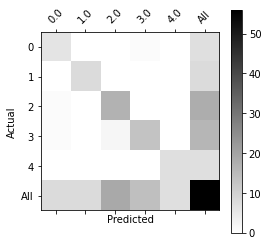

In [100]:
# START SKIP FOR GRADING
print(Y_test.shape)
print('           '+ label_to_emoji(0)+ '    ' + label_to_emoji(1) + '    ' +  label_to_emoji(2)+ '    ' + label_to_emoji(3)+'   ' + label_to_emoji(4))
print(pd.crosstab(Y_test, pred_test.reshape(56,), rownames=['Actual'], colnames=['Predicted'], margins=True))
plot_confusion_matrix(Y_test, pred_test)
# END SKIP FOR GRADING

<font color='blue'><b>What you should remember:</b>
- Even with a mere 127 training examples, you can get a reasonably good model for Emojifying. 
    - This is due to the generalization power word vectors gives you. 
- Emojify-V1 will perform poorly on sentences such as *"This movie is not good and not enjoyable"* 
    - It doesn't understand combinations of words.
    - It just averages all the words' embedding vectors together, without considering the ordering of words. 
</font>
    
**Not to worry! You will build a better algorithm in the next section!**

<a name='2'></a>
## 2 - Emojifier-V2: Using LSTMs in Keras 

You're going to build an LSTM model that takes word **sequences** as input! This model will be able to account for word ordering. 

Emojifier-V2 will continue to use pre-trained word embeddings to represent words. You'll feed word embeddings into an LSTM, and the LSTM will learn to predict the most appropriate emoji. 

### Packages

Run the following cell to load the Keras packages you'll need:

In [101]:
import numpy as np
import tensorflow
np.random.seed(0)
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Input, Dropout, LSTM, Activation
from tensorflow.keras.layers import Embedding
from tensorflow.keras.preprocessing import sequence
from tensorflow.keras.initializers import glorot_uniform
np.random.seed(1)

<a name='2-1'></a>
### 2.1 - Model Overview

Here is the Emojifier-v2 you will implement:

<img src="images/emojifier-v2.png" style="width:700px;height:400px;"> <br>
<caption><center><font color='purple'><b>Figure 3</b>: Emojifier-V2. A 2-layer LSTM sequence classifier. </center></caption>

<a name='2-2'></a>
### 2.2 Keras and Mini-batching 

In this exercise, you want to train Keras using mini-batches. However, most deep learning frameworks require that all sequences in the same mini-batch have the **same length**. 

This is what allows vectorization to work: If you had a 3-word sentence and a 4-word sentence, then the computations needed for them are different (one takes 3 steps of an LSTM, one takes 4 steps) so it's just not possible to do them both at the same time.
    
#### Padding Handles Sequences of Varying Length
* The common solution to handling sequences of **different length** is to use padding.  Specifically:
    * Set a maximum sequence length
    * Pad all sequences to have the same length. 
    
#### Example of Padding:
* Given a maximum sequence length of 20, you could pad every sentence with "0"s so that each input sentence is of length 20. 
* Thus, the sentence "I love you" would be represented as $(e_{I}, e_{love}, e_{you}, \vec{0}, \vec{0}, \ldots, \vec{0})$. 
* In this example, any sentences longer than 20 words would have to be truncated. 
* One way to choose the maximum sequence length is to just pick the length of the longest sentence in the training set. 

<a name='2-3'></a>
### 2.3 - The Embedding Layer

In Keras, the embedding matrix is represented as a "layer."

* The embedding matrix maps word indices to embedding vectors.
    * The word indices are positive integers.
    * The embedding vectors are dense vectors of fixed size.
    * A "dense" vector is the opposite of a sparse vector. It means that most of its values are non-zero.  As a counter-example, a one-hot encoded vector is not "dense."
* The embedding matrix can be derived in two ways:
    * Training a model to derive the embeddings from scratch. 
    * Using a pretrained embedding.
    
#### Using and Updating Pre-trained Embeddings
In this section, you'll create an [Embedding()](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding) layer in Keras

* You will initialize the Embedding layer with GloVe 50-dimensional vectors. 
* In the code below, you'll observe how Keras allows you to either train or leave this layer fixed.  
    * Because your training set is quite small, you'll leave the GloVe embeddings fixed instead of updating them.

#### Inputs and Outputs to the Embedding Layer

* The `Embedding()` layer's input is an integer matrix of size **(batch size, max input length)**. 
    * This input corresponds to sentences converted into lists of indices (integers).
    * The largest integer (the highest word index) in the input should be no larger than the vocabulary size.
* The embedding layer outputs an array of shape (batch size, max input length, dimension of word vectors).

* The figure shows the propagation of two example sentences through the embedding layer. 
    * Both examples have been zero-padded to a length of `max_len=5`.
    * The word embeddings are 50 units in length.
    * The final dimension of the representation is  `(2,max_len,50)`. 

<img src="images/embedding1.png" style="width:700px;height:250px;">
<caption><center><font color='purple'><b>Figure 4</b>: Embedding layer</center></caption>

#### Prepare the Input Sentences

<a name='ex-3'></a>
### Exercise 3 - sentences_to_indices

Implement `sentences_to_indices`

This function processes an array of sentences X and returns inputs to the embedding layer:

* Convert each training sentences into a list of indices (the indices correspond to each word in the sentence)
* Zero-pad all these lists so that their length is the length of the longest sentence.
    
#### Additional Hints:
* Note that you may have considered using the `enumerate()` function in the for loop, but for the purposes of passing the autograder, please follow the starter code by initializing and incrementing `j` explicitly.

In [102]:
for idx, val in enumerate(["I", "like", "learning"]):
    print(idx, val)

0 I
1 like
2 learning


In [103]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: sentences_to_indices

def sentences_to_indices(X, word_to_index, max_len):
    """
    Converts an array of sentences (strings) into an array of indices corresponding to words in the sentences.
    The output shape should be such that it can be given to `Embedding()` (described in Figure 4). 
    
    Arguments:
    X -- array of sentences (strings), of shape (m,)
    word_to_index -- a dictionary containing the each word mapped to its index
    max_len -- maximum number of words in a sentence. You can assume every sentence in X is no longer than this. 
    
    Returns:
    X_indices -- array of indices corresponding to words in the sentences from X, of shape (m, max_len)
    """
    
    m = X.shape[0]                                   # number of training examples
    
    ### START CODE HERE ###
    # Initialize X_indices as a numpy matrix of zeros and the correct shape (≈ 1 line)
    X_indices = np.zeros((m, max_len))
    
    for i in range(m):                               # loop over training examples
        
        # Convert the ith training sentence in lower case and split is into words. You should get a list of words.
        sentence_words = X[i].lower().split()
        
        # Initialize j to 0
        j = 0
        
        # Loop over the words of sentence_words

        for w in sentence_words:
            # if w exists in the word_to_index dictionary
            if w in word_to_index.keys():
                # Set the (i,j)th entry of X_indices to the index of the correct word.
                X_indices[i, j] = word_to_index[w]
                # Increment j to j + 1
                j =  j + 1
            
    ### END CODE HERE ###
    
    return X_indices

In [104]:
### YOU CANNOT EDIT THIS CELL

# UNIT TEST
def sentences_to_indices_test(target):
    
    # Create a word_to_index dictionary
    word_to_index = {}
    for idx, val in enumerate(["i", "like", "learning", "deep", "machine", "love", "smile", '´0.=']):
        word_to_index[val] = idx + 1;
       
    max_len = 4
    sentences = np.array(["I like deep learning", "deep ´0.= love machine", "machine learning smile", "$"]);
    indexes = target(sentences, word_to_index, max_len)
    print(indexes)
    
    assert type(indexes) == np.ndarray, "Wrong type. Use np arrays in the function"
    assert indexes.shape == (sentences.shape[0], max_len), "Wrong shape of ouput matrix"
    assert np.allclose(indexes, [[1, 2, 4, 3],
                                 [4, 8, 6, 5],
                                 [5, 3, 7, 0],
                                 [0, 0, 0, 0]]), "Wrong values. Debug with the given examples"
    
    print("\033[92mAll tests passed!")
    
sentences_to_indices_test(sentences_to_indices)

[[1. 2. 4. 3.]
 [4. 8. 6. 5.]
 [5. 3. 7. 0.]
 [0. 0. 0. 0.]]
All tests passed!


**Expected value**

```
[[1. 2. 4. 3.]
 [4. 8. 6. 5.]
 [5. 3. 7. 0.]
 [0. 0. 0. 0.]]
```

Run the following cell to check what `sentences_to_indices()` does, and take a look at your results.

In [105]:
X1 = np.array(["funny lol", "lets play baseball", "food is ready for you"])
X1_indices = sentences_to_indices(X1, word_to_index, max_len=5)
print("X1 =", X1)
print("X1_indices =\n", X1_indices)

X1 = ['funny lol' 'lets play baseball' 'food is ready for you']
X1_indices =
 [[155345. 225122.      0.      0.      0.]
 [220930. 286375.  69714.      0.      0.]
 [151204. 192973. 302254. 151349. 394475.]]


#### Build Embedding Layer

Now you'll build the `Embedding()` layer in Keras, using pre-trained word vectors. 

* The embedding layer takes as input a list of word indices.
    * `sentences_to_indices()` creates these word indices.
* The embedding layer will return the word embeddings for a sentence. 

<a name='ex-4'></a>
### Exercise 4 - pretrained_embedding_layer

Implement `pretrained_embedding_layer()` with these steps:

1. Initialize the embedding matrix as a numpy array of zeros.
    * The embedding matrix has a row for each unique word in the vocabulary.
        * There is one additional row to handle "unknown" words.
        * So vocab_size is the number of unique words plus one.
    * Each row will store the vector representation of one word. 
        * For example, one row may be 50 positions long if using GloVe word vectors.
    * In the code below, `emb_dim` represents the length of a word embedding.
2. Fill in each row of the embedding matrix with the vector representation of a word
    * Each word in `word_to_index` is a string.
    * word_to_vec_map is a dictionary where the keys are strings and the values are the word vectors.
3. Define the Keras embedding layer. 
    * Use [Embedding()](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding). 
    * The input dimension is equal to the vocabulary length (number of unique words plus one).
    * The output dimension is equal to the number of positions in a word embedding.
    * Make this layer's embeddings fixed.
        * If you were to set `trainable = True`, then it will allow the optimization algorithm to modify the values of the word embeddings.
        * In this case, you don't want the model to modify the word embeddings.
4. Set the embedding weights to be equal to the embedding matrix.
    * Note that this is part of the code is already completed for you and does not need to be modified! 

In [126]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: pretrained_embedding_layer

def pretrained_embedding_layer(word_to_vec_map, word_to_index):
    """
    Creates a Keras Embedding() layer and loads in pre-trained GloVe 50-dimensional vectors.
    
    Arguments:
    word_to_vec_map -- dictionary mapping words to their GloVe vector representation.
    word_to_index -- dictionary mapping from words to their indices in the vocabulary (400,001 words)

    Returns:
    embedding_layer -- pretrained layer Keras instance
    """
    
    vocab_size = len(word_to_index) + 1              # adding 1 to fit Keras embedding (requirement)
    any_word = list(word_to_vec_map.keys())[0]
    emb_dim = word_to_vec_map[any_word].shape[0]    # define dimensionality of your GloVe word vectors (= 50)
      
    ### START CODE HERE ###
    # Step 1
    # Initialize the embedding matrix as a numpy array of zeros.
    # See instructions above to choose the correct shape.
    emb_matrix = np.zeros([vocab_size, emb_dim])
    
    # Step 2
    # Set each row "idx" of the embedding matrix to be 
    # the word vector representation of the idx'th word of the vocabulary
    for word, idx in word_to_index.items():
        emb_matrix[idx, :] = word_to_vec_map[word]

    # Step 3
    # Define Keras embedding layer with the correct input and output sizes
    # Make it non-trainable.
    embedding_layer = Embedding(vocab_size, emb_dim, trainable=False)
    ### END CODE HERE ###

    # Step 4 (already done for you; please do not modify)
    # Build the embedding layer, it is required before setting the weights of the embedding layer. 
    embedding_layer.build((None,)) # Do not modify the "None".  This line of code is complete as-is.
    
    # Set the weights of the embedding layer to the embedding matrix. Your layer is now pretrained.
    embedding_layer.set_weights([emb_matrix])
    
    return embedding_layer

In [127]:
### YOU CANNOT EDIT THIS CELL

# UNIT TEST
def pretrained_embedding_layer_test(target):
    # Create a controlled word to vec map
    word_to_vec_map = {'a': [3, 3], 'synonym_of_a': [3, 3], 'a_nw': [2, 4], 'a_s': [3, 2], 'a_n': [3, 4], 
                       'c': [-2, 1], 'c_n': [-2, 2],'c_ne': [-1, 2], 'c_e': [-1, 1], 'c_se': [-1, 0], 
                       'c_s': [-2, 0], 'c_sw': [-3, 0], 'c_w': [-3, 1], 'c_nw': [-3, 2]
                      }
    # Convert lists to np.arrays
    for key in word_to_vec_map.keys():
        word_to_vec_map[key] = np.array(word_to_vec_map[key])
        
    # Create a word_to_index dictionary
    word_to_index = {}
    for idx, val in enumerate(list(word_to_vec_map.keys())):
        word_to_index[val] = idx;
        
    np.random.seed(1)
    embedding_layer = target(word_to_vec_map, word_to_index)
    
    assert type(embedding_layer) == Embedding, "Wrong type"
    assert embedding_layer.input_dim == len(list(word_to_vec_map.keys())) + 1, "Wrong input shape"
    assert embedding_layer.output_dim == len(word_to_vec_map['a']), "Wrong output shape"
    assert np.allclose(embedding_layer.get_weights(), 
                       [[[ 3, 3], [ 3, 3], [ 2, 4], [ 3, 2], [ 3, 4],
                       [-2, 1], [-2, 2], [-1, 2], [-1, 1], [-1, 0],
                       [-2, 0], [-3, 0], [-3, 1], [-3, 2], [ 0, 0]]]), "Wrong vaulues"
    print("\033[92mAll tests passed!")
       
    
pretrained_embedding_layer_test(pretrained_embedding_layer)

All tests passed!


In [128]:
embedding_layer = pretrained_embedding_layer(word_to_vec_map, word_to_index)
print("weights[0][1][1] =", embedding_layer.get_weights()[0][1][1])
print("Input_dim", embedding_layer.input_dim)
print("Output_dim",embedding_layer.output_dim)

weights[0][1][1] = 0.39031
Input_dim 400001
Output_dim 50


<a name='2-4'></a>
### 2.4 - Building the Emojifier-V2

Now you're ready to build the Emojifier-V2 model, in which you feed the embedding layer's output to an LSTM network!

<img src="images/emojifier-v2.png" style="width:700px;height:400px;"> <br>
<caption><center><font color='purple'><b>Figure 3</b>: Emojifier-v2. A 2-layer LSTM sequence classifier. </center></caption></font> 


<a name='ex-5'></a>
### Exercise 5 - Emojify_V2

Implement `Emojify_V2()`

This function builds a Keras graph of the architecture shown in Figure (3). 

* The model takes as input an array of sentences of shape (`m`, `max_len`, ) defined by `input_shape`. 
* The model outputs a softmax probability vector of shape (`m`, `C = 5`). 

* You may need to use the following Keras layers:
    * [Input()](https://www.tensorflow.org/api_docs/python/tf/keras/Input)
        * Set the `shape` and `dtype` parameters.
        * The inputs are integers, so you can specify the data type as a string, 'int32'.
    * [LSTM()](https://www.tensorflow.org/api_docs/python/tf/keras/layers/LSTM)
        * Set the `units` and `return_sequences` parameters.
    * [Dropout()](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dropout)
        * Set the `rate` parameter.
    * [Dense()](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense)
        * Set the `units`, 
        * Note that `Dense()` has an `activation` parameter.  For the purposes of passing the autograder, please do not set the activation within `Dense()`.  Use the separate `Activation` layer to do so.
    * [Activation()](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Activation)
        * You can pass in the activation of your choice as a lowercase string.
    * [Model()](https://www.tensorflow.org/api_docs/python/tf/keras/Model)
        * Set `inputs` and `outputs`.


#### Additional Hints
* Remember that these Keras layers return an object, and you will feed in the outputs of the previous layer as the input arguments to that object.  The returned object can be created and called in the same line.

```Python
# How to use Keras layers in two lines of code
dense_object = Dense(units = ...)
X = dense_object(inputs)

# How to use Keras layers in one line of code
X = Dense(units = ...)(inputs)
```

* The `embedding_layer` that is returned by `pretrained_embedding_layer` is a layer object that can be called as a function, passing in a single argument (sentence indices).

* Here is some sample code in case you're stuck: 😊
```Python
raw_inputs = Input(shape=(maxLen,), dtype='int32')
preprocessed_inputs = ... # some pre-processing
X = LSTM(units = ..., return_sequences= ...)(processed_inputs)
X = Dropout(rate = ..., )(X)
...
X = Dense(units = ...)(X)
X = Activation(...)(X)
model = Model(inputs=..., outputs=...)
...
```

In [133]:
# UNQ_C5 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Emojify_V2

def Emojify_V2(input_shape, word_to_vec_map, word_to_index):
    """
    Function creating the Emojify-v2 model's graph.
    
    Arguments:
    input_shape -- shape of the input, usually (max_len,)
    word_to_vec_map -- dictionary mapping every word in a vocabulary into its 50-dimensional vector representation
    word_to_index -- dictionary mapping from words to their indices in the vocabulary (400,001 words)

    Returns:
    model -- a model instance in Keras
    """
    
    ### START CODE HERE ###
    # Define sentence_indices as the input of the graph.
    # It should be of shape input_shape and dtype 'int32' (as it contains indices, which are integers).
    sentence_indices = Input(shape=input_shape, dtype='int32')
    
    # Create the embedding layer pretrained with GloVe Vectors (≈1 line)
    embedding_layer = pretrained_embedding_layer(word_to_vec_map, word_to_index)
    
    # Propagate sentence_indices through your embedding layer
    # (See additional hints in the instructions).
    embeddings = embedding_layer(sentence_indices)   
    
    # Propagate the embeddings through an LSTM layer with 128-dimensional hidden state
    # The returned output should be a batch of sequences.
    X = LSTM(128, return_sequences=True)(embeddings)
    # Add dropout with a probability of 0.5
    X = Dropout(0.5)(X) 
    # Propagate X trough another LSTM layer with 128-dimensional hidden state
    # The returned output should be a single hidden state, not a batch of sequences.
    X = LSTM(128)(X)
    # Add dropout with a probability of 0.5
    X = Dropout(0.5)(X)
    # Propagate X through a Dense layer with 5 units
    X = Dense(5)(X)
    # Add a softmax activation
    X = Activation('softmax')(X)
    
    # Create Model instance which converts sentence_indices into X.
    model = Model(inputs=sentence_indices, outputs=X)
    
    ### END CODE HERE ###
    
    return model

In [134]:
### YOU CANNOT EDIT THIS CELL

# UNIT TEST
from tensorflow.python.keras.engine.functional import Functional

def Emojify_V2_test(target):
    # Create a controlled word to vec map
    word_to_vec_map = {'a': [3, 3], 'synonym_of_a': [3, 3], 'a_nw': [2, 4], 'a_s': [3, 2], 'a_n': [3, 4], 
                       'c': [-2, 1], 'c_n': [-2, 2],'c_ne': [-1, 2], 'c_e': [-1, 1], 'c_se': [-1, 0], 
                       'c_s': [-2, 0], 'c_sw': [-3, 0], 'c_w': [-3, 1], 'c_nw': [-3, 2]
                      }
    # Convert lists to np.arrays
    for key in word_to_vec_map.keys():
        word_to_vec_map[key] = np.array(word_to_vec_map[key])
        
    # Create a word_to_index dictionary
    word_to_index = {}
    for idx, val in enumerate(list(word_to_vec_map.keys())):
        word_to_index[val] = idx;
        
    maxLen = 4
    model = target((maxLen,), word_to_vec_map, word_to_index)
    
    assert type(model) == Functional, "Make sure you have correctly created Model instance which converts \"sentence_indices\" into \"X\""
    
    expectedModel = [['InputLayer', [(None, 4)], 0], ['Embedding', (None, 4, 2), 30], ['LSTM', (None, 4, 128), 67072, (None, 4, 2), 'tanh', True], ['Dropout', (None, 4, 128), 0, 0.5], ['LSTM', (None, 128), 131584, (None, 4, 128), 'tanh', False], ['Dropout', (None, 128), 0, 0.5], ['Dense', (None, 5), 645, 'linear'], ['Activation', (None, 5), 0]]
    comparator(summary(model), expectedModel)
    
    
Emojify_V2_test(Emojify_V2)

All tests passed!


Run the following cell to create your model and check its summary. 

* Because all sentences in the dataset are less than 10 words, `max_len = 10` was chosen.  
* You should see that your architecture uses 20,223,927 parameters, of which 20,000,050 (the word embeddings) are non-trainable, with the remaining 223,877 being trainable. 
* Because your vocabulary size has 400,001 words (with valid indices from 0 to 400,000) there are 400,001\*50 = 20,000,050 non-trainable parameters. 

In [135]:
model = Emojify_V2((maxLen,), word_to_vec_map, word_to_index)
model.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 10)]              0         
_________________________________________________________________
embedding_5 (Embedding)      (None, 10, 50)            20000050  
_________________________________________________________________
lstm_4 (LSTM)                (None, 10, 128)           91648     
_________________________________________________________________
dropout_3 (Dropout)          (None, 10, 128)           0         
_________________________________________________________________
lstm_5 (LSTM)                (None, 128)               131584    
_________________________________________________________________
dropout_4 (Dropout)          (None, 128)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 5)                

#### Compile the Model 

As usual, after creating your model in Keras, you need to compile it and define what loss, optimizer and metrics you want to use. Compile your model using `categorical_crossentropy` loss, `adam` optimizer and `['accuracy']` metrics:

In [136]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

<a name='2-5'></a>
### 2.5 - Train the Model 

It's time to train your model! Your Emojifier-V2 `model` takes as input an array of shape (`m`, `max_len`) and outputs probability vectors of shape (`m`, `number of classes`). Thus, you have to convert X_train (array of sentences as strings) to X_train_indices (array of sentences as list of word indices), and Y_train (labels as indices) to Y_train_oh (labels as one-hot vectors).

In [137]:
X_train_indices = sentences_to_indices(X_train, word_to_index, maxLen)
Y_train_oh = convert_to_one_hot(Y_train, C = 5)

Fit the Keras model on `X_train_indices` and `Y_train_oh`, using `epochs = 50` and `batch_size = 32`.

In [138]:
model.fit(X_train_indices, Y_train_oh, epochs = 50, batch_size = 32, shuffle=True)

Epoch 1/50
5/5 [==============================] - 0s 34ms/step - loss: 1.5791 - accuracy: 0.2273
Epoch 2/50
5/5 [==============================] - 0s 39ms/step - loss: 1.5112 - accuracy: 0.2803
Epoch 3/50
5/5 [==============================] - 0s 38ms/step - loss: 1.4605 - accuracy: 0.3485
Epoch 4/50
5/5 [==============================] - 0s 23ms/step - loss: 1.3725 - accuracy: 0.5152
Epoch 5/50
5/5 [==============================] - 0s 24ms/step - loss: 1.2552 - accuracy: 0.5833
Epoch 6/50
5/5 [==============================] - 0s 25ms/step - loss: 1.1005 - accuracy: 0.6364
Epoch 7/50
5/5 [==============================] - 0s 25ms/step - loss: 0.9792 - accuracy: 0.6970
Epoch 8/50
5/5 [==============================] - 0s 37ms/step - loss: 0.9472 - accuracy: 0.5833
Epoch 9/50
5/5 [==============================] - 0s 34ms/step - loss: 0.7882 - accuracy: 0.7121
Epoch 10/50
5/5 [==============================] - 0s 34ms/step - loss: 0.7307 - accuracy: 0.7197
Epoch 11/50
5/5 [============

Your model should perform around **90% to 100% accuracy** on the training set. Exact model accuracy may vary! 

Run the following cell to evaluate your model on the test set: 

In [139]:
X_test_indices = sentences_to_indices(X_test, word_to_index, max_len = maxLen)
Y_test_oh = convert_to_one_hot(Y_test, C = 5)
loss, acc = model.evaluate(X_test_indices, Y_test_oh)
print()
print("Test accuracy = ", acc)

2/2 [==============================] - 0s 3ms/step - loss: 0.2726 - accuracy: 0.9286

Test accuracy =  0.9285714030265808


You should get a test accuracy between 80% and 95%. Run the cell below to see the mislabelled examples: 

In [140]:
# This code allows you to see the mislabelled examples
C = 5
y_test_oh = np.eye(C)[Y_test.reshape(-1)]
X_test_indices = sentences_to_indices(X_test, word_to_index, maxLen)
pred = model.predict(X_test_indices)
for i in range(len(X_test)):
    x = X_test_indices
    num = np.argmax(pred[i])
    if(num != Y_test[i]):
        print('Expected emoji:'+ label_to_emoji(Y_test[i]) + ' prediction: '+ X_test[i] + label_to_emoji(num).strip())

Expected emoji:😞 prediction: This girl is messing with me	❤️
Expected emoji:😄 prediction: you brighten my day	❤️
Expected emoji:😞 prediction: she is a bully	😄
Expected emoji:😞 prediction: My life is so boring	❤️


Now you can try it on your own example! Write your own sentence below:

In [141]:
# Change the sentence below to see your prediction. Make sure all the words are in the Glove embeddings.  
x_test = np.array(['I cannot play'])
X_test_indices = sentences_to_indices(x_test, word_to_index, maxLen)
print(x_test[0] +' '+  label_to_emoji(np.argmax(model.predict(X_test_indices))))

I cannot play ⚾


#### LSTM Version Accounts for Word Order
* The Emojify-V1 model did not "not feeling happy" correctly, but your implementation of Emojify-V2 got it right! 
    * If it didn't, be aware that Keras' outputs are slightly random each time, so this is probably why. 
* The current model still isn't very robust at understanding negation (such as "not happy")
    * This is because the training set is small and doesn't have a lot of examples of negation. 
    * If the training set were larger, the LSTM model would be much better than the Emojify-V1 model at understanding more complex sentences. 

### Congratulations!
 
You've completed this notebook, and harnessed the power of LSTMs to make your words more emotive! ❤️❤️❤️

By now, you've: 

* Created an embedding matrix
* Observed how negative sampling learns word vectors more efficiently than other methods
* Experienced the advantages and disadvantages of the GloVe algorithm
* And built a sentiment classifier using word embeddings! 

Cool! (or Emojified: 😎😎😎 ) 

<font color='blue'><b>What you should remember</b>:
- If you have an NLP task where the training set is small, using word embeddings can help your algorithm significantly. 
- Word embeddings allow your model to work on words in the test set that may not even appear in the training set. 
- Training sequence models in Keras (and in most other deep learning frameworks) requires a few important details:
    - To use mini-batches, the sequences need to be **padded** so that all the examples in a mini-batch have the **same length**. 
    - An `Embedding()` layer can be initialized with pretrained values. 
        - These values can be either fixed or trained further on your dataset. 
        - If however your labeled dataset is small, it's usually not worth trying to train a large pre-trained set of embeddings.   
    - `LSTM()` has a flag called `return_sequences` to decide if you would like to return every hidden states or only the last one. 
    - You can use `Dropout()` right after `LSTM()` to regularize your network. 


### Input sentences:
```Python
"Congratulations on finishing this assignment and building an Emojifier."
"We hope you're happy with what you've accomplished in this notebook!"
```
### Output emojis:
# 😀😀😀😀😀😀

☁ 👋🚀 ☁☁

      ✨ BYE-BYE!
      
☁ ✨  🎈

      ✨  ☁
  
         ✨
 
     ✨
 
🌾✨💨 🏃 🏠🏢                    

<a name='3'></a>
## 3 - Acknowledgments

Thanks to Alison Darcy and the Woebot team for their advice on the creation of this assignment. 
* Woebot is a chatbot friend that is ready to speak with you 24/7. 
* Part of Woebot's technology uses word embeddings to understand the emotions of what you say. 
* You can chat with Woebot by going to http://woebot.io

<img src="images/woebot.png" style="width:600px;height:300px;">